# Which logs contributing the most to cpu usage or memory usage 

In [1]:
import sys
import re
import os
from argparse import ArgumentParser
import pandas as pd
import numpy as np
import pickle as pkl
from pathlib import Path
from tqdm import tqdm
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
base_model_logs = Path("/home/alona/alona/McS/Applied_Data_Science/Thesis/Dataset/Product_review_preprocessed/Merged_data/20210517/pods_product")
base_model = Path("/home/alona/alona/McS/Applied_Data_Science/Thesis/Dataset/Product_review_preprocessed/Merged_data/20210517/pods_product/Model")

In [3]:
for file in base_model_logs.glob("*.parquet"):
    df = pd.read_parquet(file)
df

,LineId,Time,Content,EventId,EventTemplate,ParameterList,timestamp,latency,cpu_usage,memory_usage,rate_received_packets,rate_transmitted_packets,received_bandwidth,transmit_bandwidth,label
0,55,2021-05-15 04:17:17,info\tSubchannel Connectivity change to CONNEC...,46,info <*> Connectivity change to <*>,"['Subchannel', 'CONNECTING']",2021-05-15 04:17:17,60.062500,0.006184,276910080.0,6.638981,4.954141,720.174026,3969.906942,Book_Info_product
1,56,2021-05-15 04:17:17,info\ttransport: loopyWriter.run returning. co...,47,info transport: loopyWriter.run returning. con...,[],2021-05-15 04:17:17,60.062500,0.006184,276910080.0,6.638981,4.954141,720.174026,3969.906942,Book_Info_product
2,57,2021-05-15 04:17:17,info\tpickfirstBalancer: HandleSubConnStateCha...,48,info pickfirstBalancer: HandleSubConnStateChan...,['{CONNECTING'],2021-05-15 04:17:17,60.062500,0.006184,276910080.0,6.638981,4.954141,720.174026,3969.906942,Book_Info_product
3,58,2021-05-15 04:17:17,info\tChannel Connectivity change to CONNECTING,46,info <*> Connectivity change to <*>,"['Channel', 'CONNECTING']",2021-05-15 04:17:17,60.062500,0.006184,276910080.0,6.638981,4.954141,720.174026,3969.906942,Book_Info_product
4,59,2021-05-15 04:17:17,"info\tSubchannel picks a new address ""istiod-b...",49,"info Subchannel picks a new address ""istiod-ba...",[],2021-05-15 04:17:17,60.062500,0.006184,276910080.0,6.638981,4.954141,720.174026,3969.906942,Book_Info_product
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
851,906,2021-05-17 01:36:16,info\tpickfirstBalancer: HandleSubConnStateCha...,48,info pickfirstBalancer: HandleSubConnStateChan...,['{CONNECTING'],2021-05-17 01:36:16,24536.571429,0.006671,262672384.0,6.421190,5.005871,703.070131,6518.880168,Book_Info_product
852,907,2021-05-17 01:36:16,info\tChannel Connectivity change to CONNECTING,46,info <*> Connectivity change to <*>,"['Channel', 'CONNECTING']",2021-05-17 01:36:16,24536.571429,0.006671,262672384.0,6.421190,5.005871,703.070131,6518.880168,Book_Info_product
853,908,2021-05-17 01:36:16,info\tSubchannel Connectivity change to READY,46,info <*> Connectivity change to <*>,"['Subchannel', 'READY']",2021-05-17 01:36:16,24536.571429,0.006671,262672384.0,6.421190,5.005871,703.070131,6518.880168,Book_Info_product
854,909,2021-05-17 01:36:16,info\tpickfirstBalancer: HandleSubConnStateCha...,48,info pickfirstBalancer: HandleSubConnStateChan...,['{READY'],2021-05-17 01:36:16,24536.571429,0.006671,262672384.0,6.421190,5.005871,703.070131,6518.880168,Book_Info_product


In [4]:
count_p = sum(1 for f in os.listdir(base_model_logs) if f.endswith(".parquet"))
print(f"Number of files: {count_p}")

Number of files: 109


In [64]:
from pathlib import Path
import pandas as pd

base_model_logs = Path("/home/alona/alona/McS/Applied_Data_Science/Thesis/Dataset/Product_review_preprocessed/Merged_data/20210517/pods_product")

# Substrings to match
target_substrings = [
    "kube-apiserver-ocp4-control-plane-1",
    "kube-apiserver-ocp4-control-plane-2",
    "kube-apiserver-ocp4-control-plane-3",
    "kube_controller_manager_plane1",
    "etcd-ocp4-control-plane-1",
    "etcd-ocp4-control-plane-2",
    "etcd-ocp4-control-plane-3",
    #"productpage-v1-6687ddf68f-pbdzm"
]

all_dfs = []

for file in base_model_logs.glob('*.parquet'):
    matched_substring = next((s for s in target_substrings if s in file.stem), None)
    if matched_substring:
        df = pd.read_parquet(file)
        df['service'] = matched_substring  # Keep only the matched substring
        df = df[['Time', 'LineId', 'Content', 'EventId', 'EventTemplate', 'ParameterList', 'cpu_usage', 'memory_usage', 'service']]
        all_dfs.append(df)

merged_df = pd.concat(all_dfs, ignore_index=True)

In [65]:
merged_df

,Time,LineId,Content,EventId,EventTemplate,ParameterList,cpu_usage,memory_usage,service
0,2021-05-15 03:53:58,8794,.726889 I | etcdserver/api/etcdhttp: /health OK (status code 200),19,<*> I | etcdserver/api/etcdhttp: /health OK (status code 200),['.726889'],0.137775,3.268047e+09,etcd-ocp4-control-plane-2
1,2021-05-15 03:53:58,8795,.726889 I | etcdserver/api/etcdhttp: /health OK (status code 200),19,<*> I | etcdserver/api/etcdhttp: /health OK (status code 200),['.726889'],0.137775,3.268047e+09,etcd-ocp4-control-plane-2
2,2021-05-15 03:53:59,8796,".077796 I | embed: rejected connection from ""192.168.57.212:37924"" (error ""EOF"", ServerName """")",18,"<*> I | embed: rejected connection from <*> (error ""EOF"", ServerName """")","['.077796', '""192.168.57.212:37924""']",0.137775,3.268047e+09,etcd-ocp4-control-plane-2
3,2021-05-15 03:53:59,8797,".077796 I | embed: rejected connection from ""192.168.57.212:37924"" (error ""EOF"", ServerName """")",18,"<*> I | embed: rejected connection from <*> (error ""EOF"", ServerName """")","['.077796', '""192.168.57.212:37924""']",0.137775,3.268047e+09,etcd-ocp4-control-plane-2
4,2021-05-15 03:54:03,8798,.707759 I | etcdserver/api/etcdhttp: /health OK (status code 200),19,<*> I | etcdserver/api/etcdhttp: /health OK (status code 200),['.707759'],0.137775,3.268047e+09,etcd-ocp4-control-plane-2
...,...,...,...,...,...,...,...,...,...
933633,2021-05-17 02:05:58,236186,"parsed scheme: ""passthrough",62,"parsed scheme: ""passthrough",[],0.366336,5.382320e+09,kube-apiserver-ocp4-control-plane-3
933634,2021-05-17 02:05:58,236187,ccResolverWrapper: sending update to cc: {[{https://192.168.57.211:2379 <nil> 0 <nil>}] <nil> <nil>},61,ccResolverWrapper: sending update to cc: <*> <nil> 0 <nil>}] <nil> <nil>},['{[{https://192.168.57.211:2379'],0.366336,5.382320e+09,kube-apiserver-ocp4-control-plane-3
933635,2021-05-17 02:05:58,236188,"pickfirstBalancer: HandleSubConnStateChange: 0xc016f7f050, {CONNECTING <nil>}",63,pickfirstBalancer: HandleSubConnStateChange: <*> <*> <nil>},"['0xc016f7f050,', '{CONNECTING']",0.366336,5.382320e+09,kube-apiserver-ocp4-control-plane-3
933636,2021-05-17 02:05:58,236189,"pickfirstBalancer: HandleSubConnStateChange: 0xc016f7f050, {READY <nil>}",63,pickfirstBalancer: HandleSubConnStateChange: <*> <*> <nil>},"['0xc016f7f050,', '{READY']",0.366336,5.382320e+09,kube-apiserver-ocp4-control-plane-3


Label counts:
Label
0    891610
1     42028
Name: count, dtype: int64


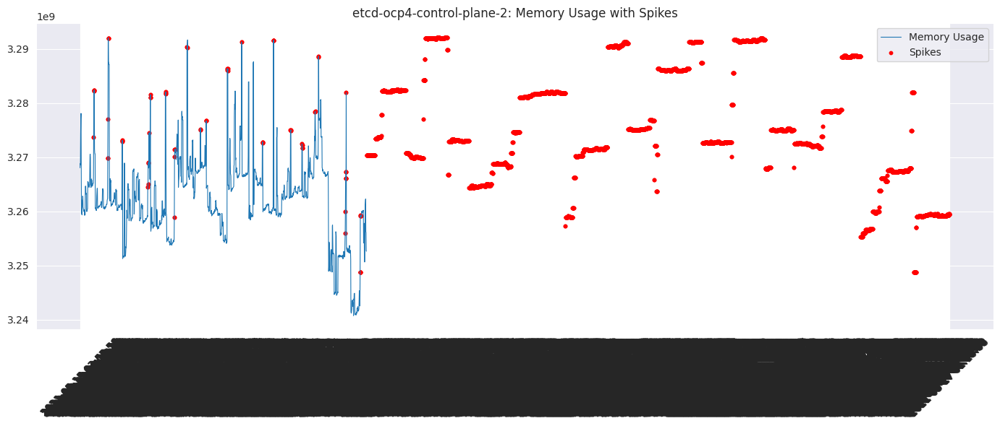

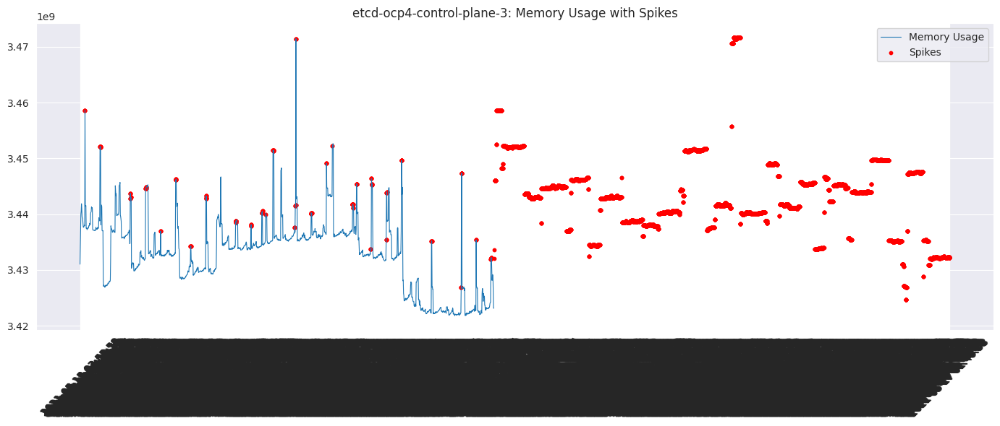

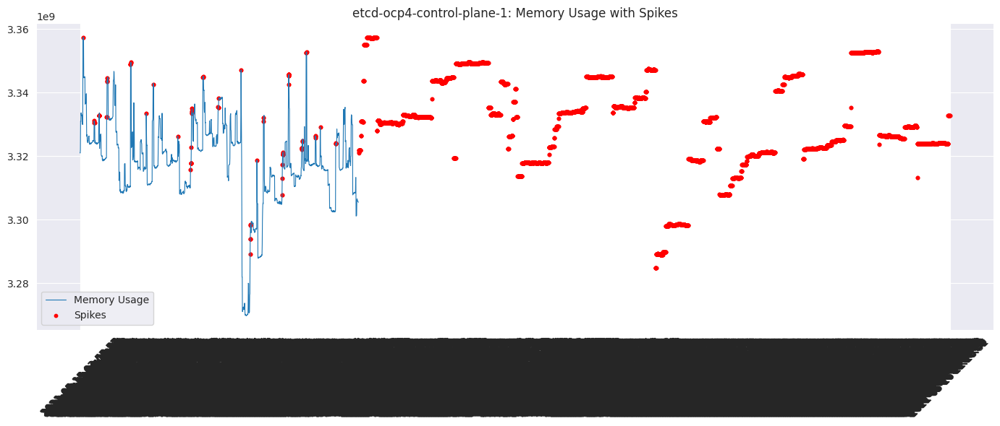

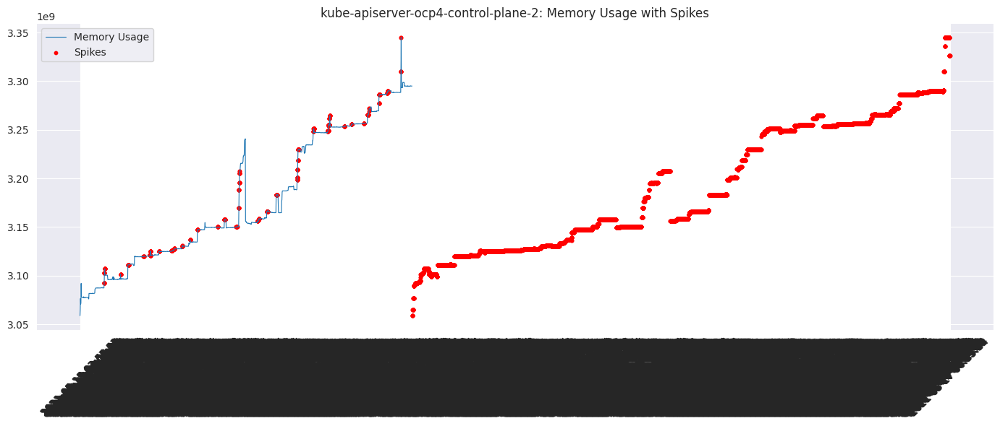

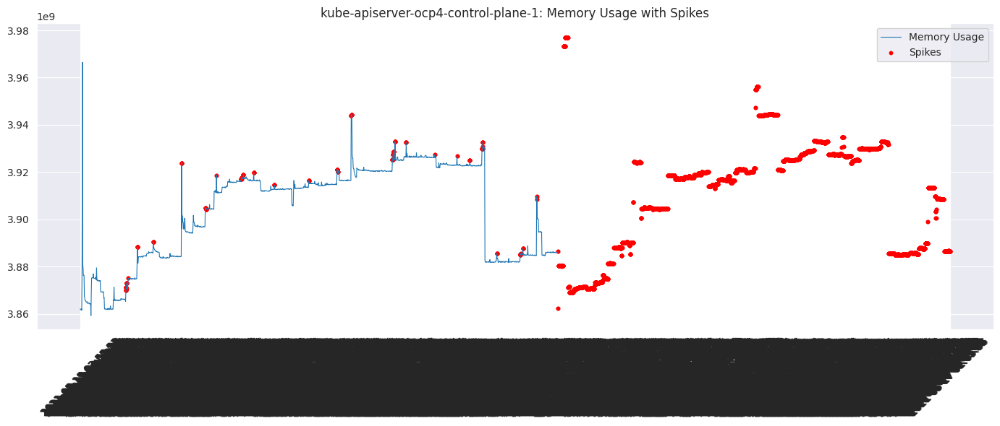

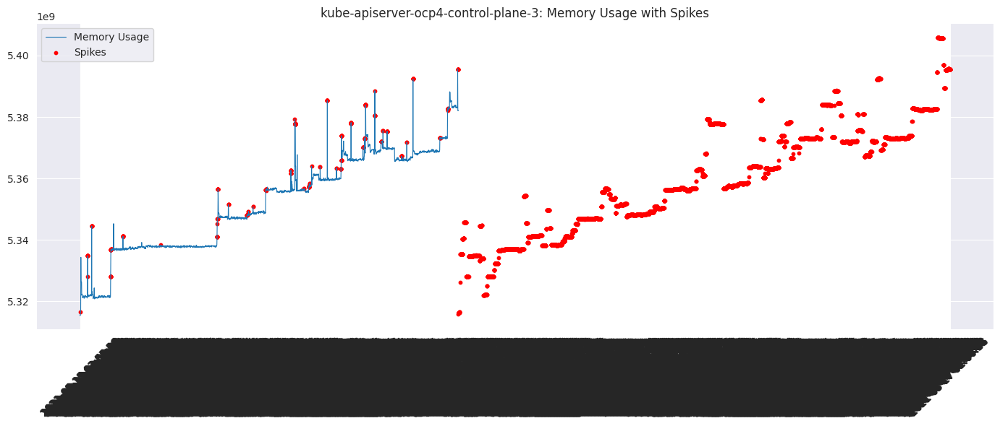

In [66]:
# === Define spike detection ===
def detect_memory_spikes(df, window=3600, threshold=3):
    df = df.sort_values('Time')
    df['memory_rolling_mean'] = df['memory_usage'].rolling(window=window, min_periods=1).mean()
    df['memory_rolling_std'] = df['memory_usage'].rolling(window=window, min_periods=1).std()
    df['memory_spike'] = (df['memory_usage'] - df['memory_rolling_mean'] > threshold * df['memory_rolling_std']).astype(int)
    return df.drop(columns=['memory_rolling_mean', 'memory_rolling_std'])

# === Apply spike detection & labeling for each service ===
merged_df['memory_spike'] = 0  # initialize
merged_df['Label'] = 0

for service in merged_df['service'].unique():
    mask = merged_df['service'] == service
    df_service = merged_df.loc[mask].copy()
    df_service = detect_memory_spikes(df_service)
    # Update merged_df with results for this service
    merged_df.loc[mask, 'memory_spike'] = df_service['memory_spike']
    merged_df.loc[mask, 'Label'] = df_service['memory_spike']  # Label = spike

print("Label counts:")
print(merged_df['Label'].value_counts())

# === plot a quick example ===
import matplotlib.pyplot as plt

for service in merged_df['service'].unique():
    df_plot = merged_df[merged_df['service'] == service].copy()
    spikes = df_plot[df_plot['Label'] == 1]

    plt.figure(figsize=(14, 6))
    plt.plot(df_plot['Time'].values[::100], df_plot['memory_usage'].values[::100],
             label='Memory Usage', linewidth=0.8)
    plt.scatter(spikes['Time'], spikes['memory_usage'], color='red',
                label='Spikes', s=10)
    plt.title(f"{service}: Memory Usage with Spikes")
    plt.legend()
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


In [67]:
eventid_counts = merged_df.groupby('service')['EventId'].nunique().reset_index()
eventid_counts = eventid_counts.rename(columns={'EventId': 'unique_eventid_count'})
print(eventid_counts)

                               service  unique_eventid_count
0            etcd-ocp4-control-plane-1                    30
1            etcd-ocp4-control-plane-2                    25
2            etcd-ocp4-control-plane-3                    27
3  kube-apiserver-ocp4-control-plane-1                   284
4  kube-apiserver-ocp4-control-plane-2                    83
5  kube-apiserver-ocp4-control-plane-3                  1421


## get labeled anomalous logs

In [82]:
merged_df.reset_index().drop(columns = ['index'], inplace = True)
merged_df

,Time,LineId,Content,EventId,EventTemplate,ParameterList,cpu_usage,memory_usage,service,memory_spike,Label,cluster
0,2021-05-15 03:53:58,8794,.726889 I | etcdserver/api/etcdhttp: /health OK (status code 200),19,<*> I | etcdserver/api/etcdhttp: /health OK (status code 200),['.726889'],0.137775,3.268047e+09,etcd-ocp4-control-plane-2,0,0,3218
1,2021-05-15 03:53:58,8795,.726889 I | etcdserver/api/etcdhttp: /health OK (status code 200),19,<*> I | etcdserver/api/etcdhttp: /health OK (status code 200),['.726889'],0.137775,3.268047e+09,etcd-ocp4-control-plane-2,0,0,3218
2,2021-05-15 03:53:59,8796,".077796 I | embed: rejected connection from ""192.168.57.212:37924"" (error ""EOF"", ServerName """")",18,"<*> I | embed: rejected connection from <*> (error ""EOF"", ServerName """")","['.077796', '""192.168.57.212:37924""']",0.137775,3.268047e+09,etcd-ocp4-control-plane-2,0,0,1515
3,2021-05-15 03:53:59,8797,".077796 I | embed: rejected connection from ""192.168.57.212:37924"" (error ""EOF"", ServerName """")",18,"<*> I | embed: rejected connection from <*> (error ""EOF"", ServerName """")","['.077796', '""192.168.57.212:37924""']",0.137775,3.268047e+09,etcd-ocp4-control-plane-2,0,0,1515
4,2021-05-15 03:54:03,8798,.707759 I | etcdserver/api/etcdhttp: /health OK (status code 200),19,<*> I | etcdserver/api/etcdhttp: /health OK (status code 200),['.707759'],0.137775,3.268047e+09,etcd-ocp4-control-plane-2,0,0,-1
...,...,...,...,...,...,...,...,...,...,...,...,...
933633,2021-05-17 02:05:58,236186,"parsed scheme: ""passthrough",62,"parsed scheme: ""passthrough",[],0.366336,5.382320e+09,kube-apiserver-ocp4-control-plane-3,0,0,0
933634,2021-05-17 02:05:58,236187,ccResolverWrapper: sending update to cc: {[{https://192.168.57.211:2379 <nil> 0 <nil>}] <nil> <nil>},61,ccResolverWrapper: sending update to cc: <*> <nil> 0 <nil>}] <nil> <nil>},['{[{https://192.168.57.211:2379'],0.366336,5.382320e+09,kube-apiserver-ocp4-control-plane-3,0,0,9
933635,2021-05-17 02:05:58,236188,"pickfirstBalancer: HandleSubConnStateChange: 0xc016f7f050, {CONNECTING <nil>}",63,pickfirstBalancer: HandleSubConnStateChange: <*> <*> <nil>},"['0xc016f7f050,', '{CONNECTING']",0.366336,5.382320e+09,kube-apiserver-ocp4-control-plane-3,0,0,32
933636,2021-05-17 02:05:58,236189,"pickfirstBalancer: HandleSubConnStateChange: 0xc016f7f050, {READY <nil>}",63,pickfirstBalancer: HandleSubConnStateChange: <*> <*> <nil>},"['0xc016f7f050,', '{READY']",0.366336,5.382320e+09,kube-apiserver-ocp4-control-plane-3,0,0,-1


In [78]:
from sentence_transformers import SentenceTransformer

model = SentenceTransformer('all-MiniLM-L6-v2')
embeddings = model.encode(
    merged_df['Content'].tolist(),
    show_progress_bar=True,
    convert_to_numpy=True
)

Batches:   0%|          | 0/29177 [00:00<?, ?it/s]

In [79]:
import numpy as np
X = embeddings

y = merged_df['Label'].values
X

array([[-0.10784087,  0.0867793 , -0.01187267, ...,  0.04532588,
         0.0200178 ,  0.01583925],
       [-0.10784087,  0.0867793 , -0.01187267, ...,  0.04532588,
         0.0200178 ,  0.01583925],
       [-0.00946309, -0.02709549, -0.01235649, ...,  0.01246382,
        -0.03347963, -0.03555898],
       ...,
       [-0.12892595, -0.0539577 , -0.03867781, ...,  0.02258416,
        -0.07628432,  0.01067384],
       [-0.11779403, -0.05808933, -0.03321663, ...,  0.00405274,
        -0.06450589,  0.02263437],
       [ 0.01403164, -0.05459294, -0.04846412, ...,  0.10858884,
        -0.01498495, -0.03190771]], shape=(933638, 384), dtype=float32)

In [59]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report

# 1. First split: train vs (val+test)
X_temp, X_test, y_temp, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

# 2. Second split: train vs val (from temp)
X_train, X_val, y_train, y_val = train_test_split(
    X_temp, y_temp, test_size=0.25, random_state=42, stratify=y_temp
)
# Here: 0.25 * 0.8 = 0.2 → so final split is 60% train, 20% val, 20% test.

In [62]:
# Train the model
clf = RandomForestClassifier(
    n_estimators=100,
    class_weight='balanced',
    random_state=42,
    n_jobs=-1
)
clf.fit(X_train, y_train)

,n_estimators,100
,criterion,'gini'
,max_depth,None
,min_samples_split,2
,min_samples_leaf,1
,min_weight_fraction_leaf,0.0
,max_features,'sqrt'
,max_leaf_nodes,None
,min_impurity_decrease,0.0
,bootstrap,True
,oob_score,False


In [63]:
# Tune & monitor on validation
y_val_pred = clf.predict(X_val)
print(classification_report(y_val, y_val_pred))

# Only once final: evaluate on the test set
y_test_pred = clf.predict(X_test)
print(classification_report(y_test, y_test_pred))

              precision    recall  f1-score   support

           0       0.96      0.45      0.62     27948
           1       0.03      0.52      0.07      1059

    accuracy                           0.45     29007
   macro avg       0.50      0.49      0.34     29007
weighted avg       0.93      0.45      0.60     29007

              precision    recall  f1-score   support

           0       0.96      0.45      0.61     27948
           1       0.04      0.54      0.07      1059

    accuracy                           0.45     29007
   macro avg       0.50      0.50      0.34     29007
weighted avg       0.93      0.45      0.59     29007



## HDBSACN

### Idea is to train a clustering model on log embeddings;
### Score memory/cpu usage stats per cluster;
### Use these as features for a lightweight classifier or anomaly ranker.

In [69]:
from sklearn.decomposition import PCA

import numpy as np
import pandas as pd
import umap.umap_ as umap
import hdbscan
import matplotlib.pyplot as plt

# Now you can:
# - Use anomaly_label as a weak signal
# - Train a lightweight classifier on cluster stats
# - Visualize with UMAP or t-SNE
# ===============================================


## Checking clusters (just visualisation)

In [70]:
# Subsample for quick tests
n_samples = 50000  # or use full set if RAM allows
X = embeddings[:n_samples]
y_sampled = merged_df['Label'][:n_samples] 

In [71]:
y_sampled.shape

(50000,)

/home/alona/alona/McS/Applied_Data_Science/Thesis/Code/pythonProject/.venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/home/alona/alona/McS/Applied_Data_Science/Thesis/Code/pythonProject/.venv/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


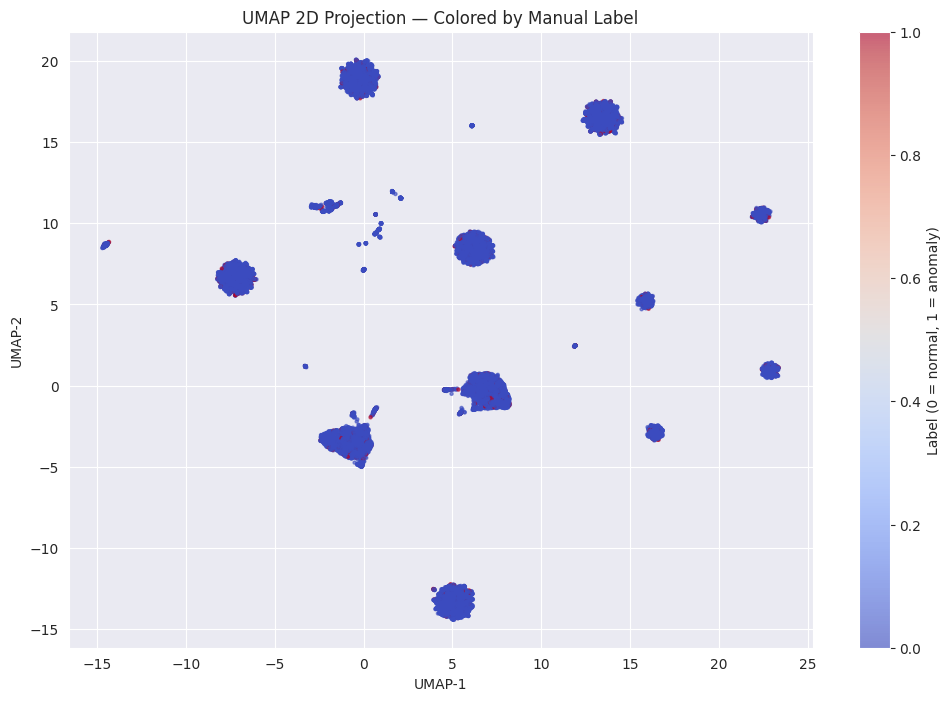

In [74]:
import umap.umap_ as umap
import matplotlib.pyplot as plt

# 1️⃣ Fit UMAP 2D on embeddings
umap_2d = umap.UMAP(
    n_neighbors=15,
    min_dist=0.1,
    n_components=2,
    metric='cosine',
    random_state=42,
    n_jobs=-1
)

X_umap_2D = umap_2d.fit_transform(X)

# Plot, color by Label
plt.figure(figsize=(12, 8))

scatter = plt.scatter(
    X_umap_2D[:, 0],
    X_umap_2D[:, 1],
    c=y_sampled,      # manual label: 0 or 1
    cmap='coolwarm',           # two colors: normal vs anomaly
    s=5,
    alpha=0.6
)

plt.title("UMAP 2D Projection — Colored by Manual Label")
plt.colorbar(scatter, label='Label (0 = normal, 1 = anomaly)')
plt.xlabel("UMAP-1")
plt.ylabel("UMAP-2")
plt.show()


## UMAP + HDBSCAN

In [87]:
umap_reducer = umap.UMAP(
    n_neighbors=30,
    min_dist=0.0,
    n_components=2,   # or 2 if you want to plot directly
    metric='cosine',
    random_state=42
)

X_umap = umap_reducer.fit_transform(embeddings)


/home/alona/alona/McS/Applied_Data_Science/Thesis/Code/pythonProject/.venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/home/alona/alona/McS/Applied_Data_Science/Thesis/Code/pythonProject/.venv/lib/python3.10/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/alona/alona/McS/Applied_Data_Science/Thesis/Code/pythonProject/.venv/lib/python3.10/site-packages/umap/spectral.py:548: UserWarning: Spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
/home/alona/alona/McS/Applied_Data_Science/Thesis/Code/pythonProject/.venv/lib/python3.10/site-packages/umap/spectral.py:548: UserWarning: Spectral initialisation fa

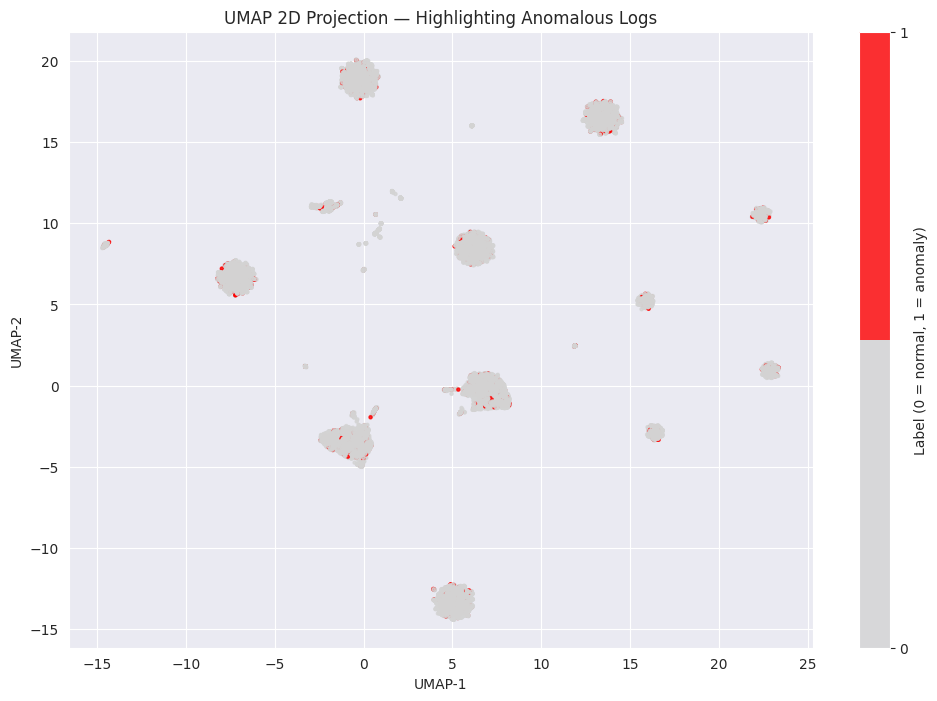

In [88]:
import matplotlib.colors as mcolors

# Define custom discrete colormap: 0 -> grey, 1 -> red
cmap = mcolors.ListedColormap(['lightgrey', 'red'])

plt.figure(figsize=(12, 8))
scatter = plt.scatter(
    X_umap_2D[:, 0],
    X_umap_2D[:, 1],
    c=y_sampled,
    cmap=cmap,
    s=5,
    alpha=0.8
)

plt.colorbar(scatter, ticks=[0, 1], label='Label (0 = normal, 1 = anomaly)')
plt.title("UMAP 2D Projection — Highlighting Anomalous Logs")
plt.xlabel("UMAP-1")
plt.ylabel("UMAP-2")
plt.show()


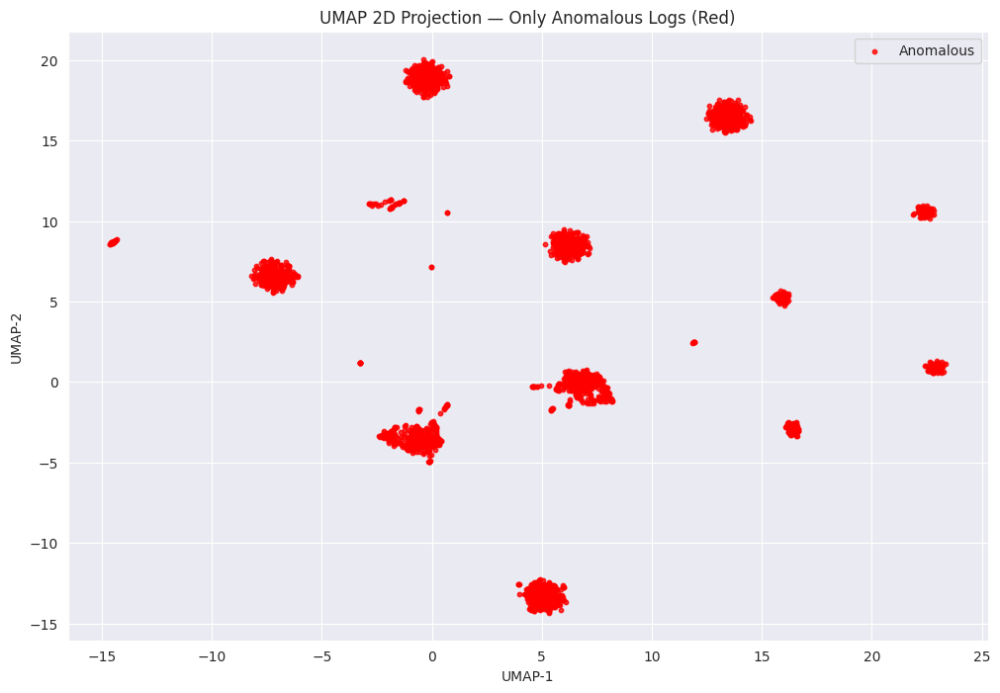

In [89]:
import matplotlib.pyplot as plt

# Mask for anomalies only
anomaly_mask = y_sampled == 1

plt.figure(figsize=(12, 8))

plt.scatter(
    X_umap_2D[anomaly_mask, 0],
    X_umap_2D[anomaly_mask, 1],
    color='red',
    s=10,
    alpha=0.8,
    label='Anomalous'
)

plt.title("UMAP 2D Projection — Only Anomalous Logs (Red)")
plt.xlabel("UMAP-1")
plt.ylabel("UMAP-2")
plt.legend()
plt.show()


In [81]:
clusterer = hdbscan.HDBSCAN(
    min_cluster_size=30,
    min_samples=10,
    prediction_data=True,
    core_dist_n_jobs=-1  # use all CPUs
)

merged_df['cluster'] = clusterer.fit_predict(X_umap)


/home/alona/alona/McS/Applied_Data_Science/Thesis/Code/pythonProject/.venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/home/alona/alona/McS/Applied_Data_Science/Thesis/Code/pythonProject/.venv/lib/python3.10/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


In [83]:
n_clusters = len(set(merged_df['cluster'])) - (1 if -1 in merged_df['cluster'].unique() else 0)
print(f"Identified {n_clusters} clusters (excluding noise)")


Identified 4360 clusters (excluding noise)


In [ ]:
plt.figure(figsize=(12, 6))

plt.scatter(
    X_umap[:, 0], X_umap[:, 1],
    c=merged_df['cluster'],
    cmap='tab20',
    s=5,
    alpha=0.6
)
plt.colorbar(label='HDBSCAN cluster')
plt.title("UMAP + HDBSCAN clusters")
plt.show()

# Alternative: color by your anomaly label instead:
plt.figure(figsize=(12, 6))

plt.scatter(
    X_umap[:, 0], X_umap[:, 1],
    c=merged_df['Label'],
    cmap='coolwarm',
    s=5,
    alpha=0.6
)
plt.colorbar(label='Anomaly Label (0=normal, 1=anomalous)')
plt.title("UMAP projection colored by manual anomaly label")
plt.show()


In [ ]:
merged_df['UMAP_1'] = X_umap[:, 0]
merged_df['UMAP_2'] = X_umap[:, 1]
merged_df.to_csv('logs_with_umap_hdbscan.csv', index=False)


## for whole 

In [ ]:
# STEP 4 — Check number of clusters (excluding noise)

n_clusters = len(set(merged_df['cluster'])) - (1 if -1 in merged_df['cluster'].unique() else 0)
n_noise = np.sum(merged_df['cluster'] == -1)
noise_ratio = n_noise / len(merged_df)

print(f"Identified {n_clusters} clusters")
print(f"Noise points: {n_noise} ({noise_ratio:.2%})")

In [ ]:
# STEP 5 — Compute telemetry stats per cluster

# Exclude noise (-1) for stats
cluster_stats = merged_df[merged_df['cluster'] != -1].groupby('cluster').agg({
    'memory_usage': ['mean', 'std', 'max'],
    'cpu_usage': ['mean', 'std', 'max']  # optional
}).reset_index()

# Flatten MultiIndex
cluster_stats.columns = ['cluster', 'mem_mean', 'mem_std', 'mem_max',
                         'cpu_mean', 'cpu_std', 'cpu_max']

print(cluster_stats.head())

In [ ]:
# STEP 6 — Merge back to log level

merged_df = merged_df.merge(cluster_stats, on='cluster', how='left')

In [ ]:
# STEP 7 — Label noise as anomaly (optional)

merged_df['anomaly_label'] = (merged_df['cluster'] == -1).astype(int)

In [ ]:
# STEP 8 — Quick summary

print(merged_df[['cluster', 'anomaly_label']].value_counts())

In [ ]:
n_unique_templates = merged_df['EventId'].nunique()
print(f"Number of unique EventIds: {n_unique_templates}")

## Other

In [8]:
from sklearn.feature_extraction.text import ENGLISH_STOP_WORDS

stop_words = list(ENGLISH_STOP_WORDS) + ['http', 'https', 'com', 'amp', '<', '>', '*', '[', ']', '']

def clean_log_template(text):
    text = text.lower()
    # Remove special characters except <*>
    text = re.sub(r'[^\w\s<>]', '', text)
    # Remove stopwords
    words = text.split()
    words = [word for word in words if word not in stop_words]
    return ' '.join(words)

logs_metrics['LogTemplate_clean'] = logs_metrics['LogTemplate'].astype(str).apply(clean_log_template)

logs_metrics[['LogTemplate', 'LogTemplate_clean']].head()

,LogTemplate,LogTemplate_clean
time,,
1621050840,Zipkin span batch processed by the collector.,zipkin span batch processed collector
1621050840,Span written to the storage by the collector,span written storage collector
1621050840,Span written to the storage by the collector,span written storage collector
1621050840,Span written to the storage by the collector,span written storage collector
1621050840,Span written to the storage by the collector,span written storage collector


In [9]:
logs_metrics['LogTemplate_clean'].nunique()
print(logs_metrics['LogTemplate_clean'].value_counts().head(20))

LogTemplate_clean
span written storage collector                                                     3237744
<> <> http11 200 <>                                                                 991680
debugurllib3connectionpoolstarting new connection 1 <>                              968266
zipkin span batch processed collector                                               673545
> details0                                                                          416171
<> <> http11 200                                                                    415071
debugurllib3connectionpoolhttpreviews9080 reviews0 http11 <> <>                     201311
throttling request took <> request <>                                               131243
syncing secrets kubeschedulerclientcertkey false                                     59032
syncing configmaps                                                                   59026
ratings0                                                                

## Extracting log embeddings

In [43]:
from sentence_transformers import SentenceTransformer

model = SentenceTransformer('sentence-transformers/all-MiniLM-L6-v2')
log_embeddings = model.encode(logs_metrics['LogTemplate'].tolist(), show_progress_bar=True)

ImportError: cannot import name 'cached_download' from 'huggingface_hub' (/home/alona/alona/McS/Applied_Data_Science/Thesis/Code/pythonProject/.venv/lib/python3.10/site-packages/huggingface_hub/__init__.py)

In [12]:
embedding_df = pd.DataFrame(log_embeddings, index=logs_metrics.index)

In [7]:
logs_metrics = logs_metrics.reset_index()

#  key for merging
logs_metrics['merge_key'] = logs_metrics['time'].astype(str) + '_' + logs_metrics['service']
embedding_df['merge_key'] = logs_metrics['merge_key'].values  # align keys

In [8]:
logs_metrics.drop(columns = 'index')

KeyError: "['index'] not found in axis"

In [9]:
logs_metrics = logs_metrics.set_index('merge_key')
embedding_df = embedding_df.set_index('merge_key')

In [10]:
logs_metrics

,time,LogTemplate,service,latency,cpu_usage,memory_usage,rate_received_packets,rate_transmitted_packets,received_bandwidth,transmit_bandwidth,service_type
merge_key,,,,,,,,,,,
1621050840_jaeger-85b754b6c5-7jvpm,1621050840,Zipkin span batch processed by the collector.,jaeger-85b754b6c5-7jvpm,60.548851,0.069964,3.381854e+09,99.185930,89.221271,196997.004838,16770.058331,jaeger
1621050840_jaeger-85b754b6c5-7jvpm,1621050840,Span written to the storage by the collector,jaeger-85b754b6c5-7jvpm,60.548851,0.069964,3.381854e+09,99.185930,89.221271,196997.004838,16770.058331,jaeger
1621050840_jaeger-85b754b6c5-7jvpm,1621050840,Span written to the storage by the collector,jaeger-85b754b6c5-7jvpm,60.548851,0.069964,3.381854e+09,99.185930,89.221271,196997.004838,16770.058331,jaeger
1621050840_jaeger-85b754b6c5-7jvpm,1621050840,Span written to the storage by the collector,jaeger-85b754b6c5-7jvpm,60.548851,0.069964,3.381854e+09,99.185930,89.221271,196997.004838,16770.058331,jaeger
1621050840_jaeger-85b754b6c5-7jvpm,1621050840,Span written to the storage by the collector,jaeger-85b754b6c5-7jvpm,60.548851,0.069964,3.381854e+09,99.185930,89.221271,196997.004838,16770.058331,jaeger
...,...,...,...,...,...,...,...,...,...,...,...
1621217150_jaeger-85b754b6c5-7jvpm,1621217150,Span written to the storage by the collector,jaeger-85b754b6c5-7jvpm,2976.441974,0.061656,2.415532e+09,74.120639,71.455599,143726.093321,16273.219431,jaeger
1621217150_jaeger-85b754b6c5-7jvpm,1621217150,Span written to the storage by the collector,jaeger-85b754b6c5-7jvpm,2976.441974,0.061656,2.415532e+09,74.120639,71.455599,143726.093321,16273.219431,jaeger
1621217150_productpage-v1-6687ddf68f-pbdzm,1621217150,DEBUG:urllib3.connectionpool:Starting new HTTP...,productpage-v1-6687ddf68f-pbdzm,3028.340662,0.366162,5.376198e+09,498.017717,535.774020,221172.365731,422445.363315,productpage


In [12]:
logs_metrics.to_parquet(
    base_model / "logs_metrics.parquet",
    index=False,
    engine="pyarrow",
    compression="snappy",
    use_deprecated_int96_timestamps=True,
    coerce_timestamps="ms",
    write_statistics=True
)

In [11]:
embedding_df

,0,1,2,3,4,5,6,7,8,9,...,374,375,376,377,378,379,380,381,382,383
merge_key,,,,,,,,,,,,,,,,,,,,,
1621050840_jaeger-85b754b6c5-7jvpm,-0.095936,0.071603,-0.101386,0.077629,-0.019497,-0.069172,0.005616,-0.011056,-0.014809,0.024715,...,0.030845,0.041635,-0.032147,-0.076352,0.054812,0.049485,0.022876,-0.058033,0.043371,-0.011458
1621050840_jaeger-85b754b6c5-7jvpm,-0.037805,0.108295,-0.076720,0.084061,-0.065390,-0.021827,0.015607,0.002952,0.039059,0.042491,...,-0.011023,-0.029505,0.037281,-0.003452,0.000948,0.033233,0.100263,-0.025080,0.017278,0.045564
1621050840_jaeger-85b754b6c5-7jvpm,-0.037805,0.108295,-0.076720,0.084061,-0.065390,-0.021827,0.015607,0.002952,0.039059,0.042491,...,-0.011023,-0.029505,0.037281,-0.003452,0.000948,0.033233,0.100263,-0.025080,0.017278,0.045564
1621050840_jaeger-85b754b6c5-7jvpm,-0.037805,0.108295,-0.076720,0.084061,-0.065390,-0.021827,0.015607,0.002952,0.039059,0.042491,...,-0.011023,-0.029505,0.037281,-0.003452,0.000948,0.033233,0.100263,-0.025080,0.017278,0.045564
1621050840_jaeger-85b754b6c5-7jvpm,-0.037805,0.108295,-0.076720,0.084061,-0.065390,-0.021827,0.015607,0.002952,0.039059,0.042491,...,-0.011023,-0.029505,0.037281,-0.003452,0.000948,0.033233,0.100263,-0.025080,0.017278,0.045564
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1621217150_jaeger-85b754b6c5-7jvpm,-0.037805,0.108295,-0.076720,0.084061,-0.065390,-0.021827,0.015607,0.002952,0.039059,0.042491,...,-0.011023,-0.029505,0.037281,-0.003452,0.000948,0.033233,0.100263,-0.025080,0.017278,0.045564
1621217150_jaeger-85b754b6c5-7jvpm,-0.037805,0.108295,-0.076720,0.084061,-0.065390,-0.021827,0.015607,0.002952,0.039059,0.042491,...,-0.011023,-0.029505,0.037281,-0.003452,0.000948,0.033233,0.100263,-0.025080,0.017278,0.045564
1621217150_productpage-v1-6687ddf68f-pbdzm,0.014773,-0.091767,-0.049411,0.004532,-0.042720,-0.116094,-0.054762,-0.099125,0.025283,-0.056440,...,0.048541,0.060737,-0.021057,-0.030046,-0.054133,0.005347,0.035327,0.003257,0.018930,-0.010784


In [13]:
embedding_df.to_parquet(
    base_model / "embedding_df.parquet",
    index=False,
    engine="pyarrow",
    compression="snappy",
    use_deprecated_int96_timestamps=True,
    coerce_timestamps="ms",
    write_statistics=True
)

In [ ]:
combined_df = logs_metrics.join(embedding_df, how='inner', on='merge_key').reset_index()

In [1]:
embedding_df

NameError: name 'embedding_df' is not defined

In [ ]:
combined_df = pd.merge(
    logs_metrics[['cpu_usage', 'memory_usage', 'time', 'service', 'LogTemplate', 'service_type', 'merge_key']],
    embedding_df,
    on='merge_key',
    how='inner'
)

In [ ]:
combined_df

In [11]:
combined_df.to_parquet(
    base_model / "combined_df.parquet",
    index=False,
    engine="pyarrow",
    compression="snappy",
    use_deprecated_int96_timestamps=True,
    coerce_timestamps="ms",
    write_statistics=True
)

In [13]:
embedding_df.to_parquet(
    base_model / "logs_embeddings.parquet",
    index=False,
    engine="pyarrow",
    compression="snappy",
    use_deprecated_int96_timestamps=True,
    coerce_timestamps="ms",
    write_statistics=True
)

In [6]:
embedding_df = pd.read_parquet(base_model / "logs_embeddings.parquet")
embedding_df

,0,1,2,3,4,5,6,7,8,9,...,374,375,376,377,378,379,380,381,382,383
0,-0.095936,0.071603,-0.101386,0.077629,-0.019497,-0.069172,0.005616,-0.011056,-0.014809,0.024715,...,0.030845,0.041635,-0.032147,-0.076352,0.054812,0.049485,0.022876,-0.058033,0.043371,-0.011458
1,-0.037805,0.108295,-0.076720,0.084061,-0.065390,-0.021827,0.015607,0.002952,0.039059,0.042491,...,-0.011023,-0.029505,0.037281,-0.003452,0.000948,0.033233,0.100263,-0.025080,0.017278,0.045564
2,-0.037805,0.108295,-0.076720,0.084061,-0.065390,-0.021827,0.015607,0.002952,0.039059,0.042491,...,-0.011023,-0.029505,0.037281,-0.003452,0.000948,0.033233,0.100263,-0.025080,0.017278,0.045564
3,-0.037805,0.108295,-0.076720,0.084061,-0.065390,-0.021827,0.015607,0.002952,0.039059,0.042491,...,-0.011023,-0.029505,0.037281,-0.003452,0.000948,0.033233,0.100263,-0.025080,0.017278,0.045564
4,-0.037805,0.108295,-0.076720,0.084061,-0.065390,-0.021827,0.015607,0.002952,0.039059,0.042491,...,-0.011023,-0.029505,0.037281,-0.003452,0.000948,0.033233,0.100263,-0.025080,0.017278,0.045564
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7623056,-0.037805,0.108295,-0.076720,0.084061,-0.065390,-0.021827,0.015607,0.002952,0.039059,0.042491,...,-0.011023,-0.029505,0.037281,-0.003452,0.000948,0.033233,0.100263,-0.025080,0.017278,0.045564
7623057,-0.037805,0.108295,-0.076720,0.084061,-0.065390,-0.021827,0.015607,0.002952,0.039059,0.042491,...,-0.011023,-0.029505,0.037281,-0.003452,0.000948,0.033233,0.100263,-0.025080,0.017278,0.045564
7623058,0.014773,-0.091767,-0.049411,0.004532,-0.042720,-0.116094,-0.054762,-0.099125,0.025283,-0.056440,...,0.048541,0.060737,-0.021057,-0.030046,-0.054133,0.005347,0.035327,0.003257,0.018930,-0.010784
7623059,-0.068686,0.070554,-0.032335,-0.033246,-0.029688,-0.065990,-0.017548,-0.011963,-0.032280,-0.014453,...,-0.074998,0.037027,-0.018119,-0.040485,-0.016819,0.097401,0.048605,0.073184,-0.025277,0.029450


In [ ]:
combined_df = pd.read_parquet(base_model / "combined_df.parquet")
combined_df

In [1]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train_raw, y_test_raw = train_test_split(
    embedding_df, combined_df[['cpu_usage', 'memory_usage']],
    test_size=0.2, random_state=42
)

NameError: name 'embedding_df' is not defined

## *delta CPU/memory based on when the same log template (log message pattern) appears again

In [7]:
embedding_df['merge_key'] = logs_metrics['merge_key']

In [8]:
from collections import defaultdict

next_idx_map = defaultdict(list)

# Group indices by log template
template_groups = logs_metrics.groupby('LogTemplate').groups

In [9]:
from collections import defaultdict
import numpy as np

template_groups = logs_metrics.groupby(['service', 'LogTemplate']).groups

next_cpu_deltas = []
next_mem_deltas = []

for idx, row in logs_metrics.iterrows():
    key = (row['service'], row['LogTemplate'])
    group_indices = list(template_groups[key])
    pos = group_indices.index(idx)

    if pos < len(group_indices) - 1:
        next_idx = group_indices[pos + 1]
        delta_cpu = logs_metrics.loc[next_idx, 'cpu_usage'] - row['cpu_usage']
        delta_mem = logs_metrics.loc[next_idx, 'memory_usage'] - row['memory_usage']
    else:
        delta_cpu = np.nan
        delta_mem = np.nan

    next_cpu_deltas.append(delta_cpu)
    next_mem_deltas.append(delta_mem)

logs_metrics['delta_cpu_next'] = next_cpu_deltas
logs_metrics['delta_mem_next'] = next_mem_deltas

KeyboardInterrupt: 

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor

X = combined_df.filter(like='dim_')
y = combined_df[['delta_cpu_next', 'delta_mem_next']]

X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42)

model = RandomForestRegressor()
model.fit(X_train, y_train)

In [ ]:
valid = logs_metrics.dropna(subset=['delta_cpu_next', 'delta_mem_next'])
embedding_df = embedding_df.loc[valid.index].reset_index(drop=True)
valid = valid.reset_index(drop=True)

combined_df = pd.concat([valid, embedding_df.drop(columns='merge_key')], axis=1)

In [ ]:
from sklearn.preprocessing import StandardScaler

scaler_X = StandardScaler()
X_train_scaled = scaler_X.fit_transform(X_train)
X_test_scaled = scaler_X.transform(X_test)

In [ ]:
import numpy as np

y_train = np.log1p(y_train_raw)  # log1p avoids log(0) issues
y_test = np.log1p(y_test_raw)

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV

param_grid = {
    'n_estimators': [100, 200],
    'max_depth': [None, 20],
}

reg = RandomForestRegressor(random_state=42)
grid = GridSearchCV(reg, param_grid, cv=5, scoring='neg_mean_squared_error', n_jobs=-1)
grid.fit(X_train_scaled, y_train)

best_model = grid.best_estimator_

In [ ]:
from sklearn.metrics import mean_squared_error, r2_score

# Predict in log scale
y_pred_log = best_model.predict(X_test_scaled)

# Inverse transform to original scale
y_pred = np.expm1(y_pred_log)
y_test = np.expm1(y_test)

# Calculate error
mse_cpu = mean_squared_error(y_test['cpu_usage'], y_pred[:, 0])
mse_mem = mean_squared_error(y_test['memory_usage'], y_pred[:, 1])
r2 = r2_score(y_test, y_pred)

print(f"CPU MSE: {mse_cpu:.2f}, Memory MSE: {mse_mem:.2f}, R²: {r2:.2f}")

In [ ]:
import shap

explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X_test_scaled)

# One for CPU, one for memory
shap.summary_plot(shap_values[0], X_test_scaled, feature_names=[f"dim_{i}" for i in range(X.shape[1])])
shap.summary_plot(shap_values[1], X_test_scaled, feature_names=[f"dim_{i}" for i in range(X.shape[1])])

## BOW TF-IDF Vectorizer

In [9]:
from sklearn.feature_extraction.text import TfidfVectorizer

# Step 1: Collapse logs per (service, time) into "documents"
# Example log_df: ['service', 'time', 'LogTemplate']
log_docs = (
    logs_metrics.groupby(['service', 'time'])['LogTemplate_clean']
    .apply(lambda x: ' '.join(x))  # join templates as a space-separated string
    .reset_index()
)

In [9]:
log_docs

,service,time,LogTemplate_clean
0,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621050870,info abstractoperator254 reconciliation <> kaf...
1,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621050990,info clusteroperator125 triggering periodic re...
2,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621051110,info abstractoperator254 reconciliation <> kaf...
3,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621051230,info clusteroperator125 triggering periodic re...
4,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621051350,info abstractoperator254 reconciliation <> kaf...
...,...,...,...
219631,web-7565876947-rr4gm,1621200700,warning envoy config bazeloutk8optbinexternale...
219632,web-7565876947-rr4gm,1621206200,warning envoy config bazeloutk8optbinexternale...
219633,web-7565876947-rr4gm,1621207930,warning envoy config bazeloutk8optbinexternale...
219634,web-7565876947-rr4gm,1621208180,info <> connectivity change <> info <> connect...


In [15]:
# Step 2: Apply TF-IDF
tfidf = TfidfVectorizer(token_pattern=r'.+')
X_tfidf = tfidf.fit_transform(log_docs['LogTemplate_clean'])

In [16]:
X_tfidf.shape #n_windows, n_log_templates

(219636, 60328)

In [17]:
# Merge this with performance metrics:
X_df = pd.DataFrame(X_tfidf.toarray(), columns=tfidf.get_feature_names_out())
X_df


MemoryError: Unable to allocate 98.7 GiB for an array with shape (219636, 60328) and data type float64

In [25]:
X_df_sparse = pd.DataFrame.sparse.from_spmatrix(X_tfidf, columns=tfidf.get_feature_names_out())

In [26]:
X_df_sparse['service'] = log_docs['service'].values
X_df_sparse['time'] = log_docs['time'].values
X_df_sparse

<> 1 flow_mods 0 s 1 deletes <> 1 flow_mods 0 s 1 deletes > <> < > <> <  \
0                                                       0                         
1                                                       0                         
2                                                       0                         
3                                                       0                         
4                                                       0                         
...                                                   ...                         
219631                                                  0                         
219632                                                  0                         
219633                                                  0                         
219634                                                  0                         
219635                                                  0                         

        <> 1 flow_mods 0 s 1 deletes > <> < <> 1 flow_mods 0 s 1 deletes > <> <  \
0                                                       0                         
1                                                       0                         
2                                                       0                         
3                                                       0                         
4                                                       0                         
...                                                   ...                         
219631                                                  0                         
219632                                                  0                         
219633                                                  0                         
219634                                                  0                         
219635                                                  0                         

        <> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes  \
0                                                       0                             
1                                                       0                             
2                                                       0                             
3                                                       0                             
4                                                       0                             
...                                                   ...                             
219631                                                  0                             
219632                                                  0                             
219633                                                  0                             
219634                                                  0                             
219635                                                  0                             

        <> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes  \
0                                                       0                                                                                                         
1                                                       0                                                                                                         
2                                                       0                                                                                                         
3                                                       0                                                                                                         
4                                                       0                                                                                                 

In [27]:
X_df_sparse.columns

Index(['<> 1 flow_mods 0 s 1 deletes <> 1 flow_mods 0 s 1 deletes > <> < > <> <',
       '<> 1 flow_mods 0 s 1 deletes > <> < <> 1 flow_mods 0 s 1 deletes > <> <',
       '<> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes',
       '<> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes',
       '<> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes > <> < > <> <',
       '<> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes <> br0 <> interface <> port <> <> br0 <> interface <> port <> <> 68 flow_mods 0 s 67 adds 1 deletes',
       '<> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes > <> < <> 68 flow_mods 0 s 67 adds 1 deletes > <> <',
       '<> 6

In [46]:
df_joined = pd.read_parquet(base_model / "df_joined.parquet")
df_joined

,time,service,latency,cpu_usage,memory_usage,rate_received_packets,rate_transmitted_packets,received_bandwidth,transmit_bandwidth,service_type
0,1621050840,ovs-6ktdx,48.187500,0.004108,37638144.0,2241.503554,1471.905736,1.610117e+06,1.116690e+06,ovs
1,1621050930,ovs-6ktdx,60.642857,0.004093,37638144.0,3756.465807,1600.667438,3.751162e+06,1.019729e+06,ovs
2,1621051030,ovs-6ktdx,69.588235,0.004274,37494784.0,1678.661680,1446.140369,7.641298e+05,1.047357e+06,ovs
3,1621051070,ovs-6ktdx,61.866667,0.004309,37552128.0,1558.937595,1363.938183,7.240655e+05,1.061206e+06,ovs
4,1621051080,ovs-6ktdx,55.642857,0.004309,37556224.0,1558.937595,1363.938183,7.240655e+05,1.061206e+06,ovs
...,...,...,...,...,...,...,...,...,...,...
634163,1621211730,mongodb-6d6d6df9b8-fmnjt,28892.400000,0.006314,262500352.0,6.559353,4.715649,7.056800e+02,3.574831e+03,mongodb
634164,1621213390,mongodb-6d6d6df9b8-fmnjt,26162.200000,0.006345,262672384.0,6.781511,5.284114,7.361187e+02,4.643434e+03,mongodb
634165,1621213500,mongodb-6d6d6df9b8-fmnjt,29291.916667,0.006650,262795264.0,6.174344,4.427655,6.809651e+02,2.554513e+03,mongodb
634166,1621215290,mongodb-6d6d6df9b8-fmnjt,21676.636364,0.006437,262672384.0,6.460122,4.599398,7.152432e+02,3.319005e+03,mongodb


In [28]:
merged_df = X_df_sparse.merge(df_joined, on=['service', 'time'], how='inner')
merged_df

,<> 1 flow_mods 0 s 1 deletes <> 1 flow_mods 0 s 1 deletes > <> < > <> <,<> 1 flow_mods 0 s 1 deletes > <> < <> 1 flow_mods 0 s 1 deletes > <> <,<> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes,<> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes,<> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes > <> < > <> <,<> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes <> br0 <> interface <> port <> <> br0 <> interface <> port <> <> 68 flow_mods 0 s 67 adds 1 deletes,<> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes > <> < <> 68 flow_mods 0 s 67 adds 1 deletes > <> <,<> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes > <> < > <> < <> 68 flow_mods 0 s 67 adds 1 deletes,<> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes <> <> flow_mods 0 s <> <> <> <> flow_mods 0 s <> <>,<> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes <> <> flow_mods 0 s <> <> <> <> flow_mods 0 s <> <> <> 68 flow_mods 0 s 67 adds 1 deletes <> 68 flow_mods 0 s 67 adds 1 deletes <> <> flow_mods 0 s <> <> <> <> flow_mods 0 s <> <> <> br0 <> interface <> port <> <> br0 <> interface <> port <>,...,service,time,latency,cpu_usage,memory_usage,rate_received_packets,rate_transmitted_packets,received_bandwidth,transmit_bandwidth,service_type
0,0,0,0,0,0,0,0,0,0,0,...,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621050870,60.933333,0.007751,1.509925e+09,0.734924,0.835271,67.651723,68.289049,amq
1,0,0,0,0,0,0,0,0,0,0,...,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621050990,59.955556,0.007691,1.509925e+09,0.625969,0.992465,56.992965,80.095571,amq
2,0,0,0,0,0,0,0,0,0,0,...,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621051110,55.422222,0.007862,1.509949e+09,0.853728,0.989889,76.949345,80.605246,amq
3,0,0,0,0,0,0,0,0,0,0,...,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621051230,61.243697,0.007831,1.509949e+09,0.674127,1.277372,62.221923,101.399027,amq
4,0,0,0,0,0,0,0,0,0,0,...,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621051350,58.348214,0.008194,1.510023e+09,2.301291,2.260579,3715.276048,319.860990,amq
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
219631,0,0,0,0,0,0,0,0,0,0,...,web-7565876947-rr4gm,1621200700,20456.272727,0.003302,1.275372e+08,12.002182,7.321058,1094.053464,57616.885565,web
219632,0,0,0,0,0,0,0,0,0,0,...,web-7565876947-rr4gm,1621206200,2805.851852,0.003513,1.265705e+08,6.963163,6.486257,698.113208,72054.335690,web
219633,0,0,0,0,0,0,0,0,0,0,...,web-7565876947-rr4gm,1621207930,22347.200000,0.003370,1.312973e+08,6.591215,4.660270,701.617449,35525.514000,web
219634,0,0,0,0,0,0,0,0,0,0,...,web-7565876947-rr4gm,1621208180,23207.714286,0.003738,1.312973e+08,6.830020,7.139792,685.128096,71113.144239,web


In [69]:
y_cpu = merged_df['cpu_usage']

y_memory = merged_df['memory_usage']

X = merged_df.drop(columns=['service', 'time', 'cpu_usage', 'memory_usage', 'service_type', 'rate_received_packets', 'rate_transmitted_packets', 'received_bandwidth', 'transmit_bandwidth', 'latency'])

In [70]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler(with_mean=False)
X_scaled = scaler.fit_transform(X)
y_cpu_log = np.log1p(y_cpu)  # use this as target
y_memory_log = np.log1p(y_memory)

In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
    X, y_cpu_log, test_size=0.2, random_state=42
)

scaler = StandardScaler(with_mean=False)
X_train_scaled = scaler.fit_transform(X_train)

X_test_scaled = scaler.transform(X_test)


In [71]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
    X_scaled, y_cpu_log, test_size=0.2, random_state=42
)

In [79]:
import threading
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

def train_model_thread(X_train, X_test, y_train, y_test):

    model = RandomForestRegressor(
        n_estimators=100,
        random_state=42,
        n_jobs=-1
    )
    model.fit(X_train, y_train)

    y_pred = model.predict(X_test)
    mae = mean_absolute_error(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    r2  = r2_score(y_test, y_pred)

    result = f"**MAE:** {mae:.3f}  \n**MSE:** {mse:.3f}  \n**R² score:** {r2:.3f}"

In [80]:
from concurrent.futures import ThreadPoolExecutor

executor = ThreadPoolExecutor(max_workers=5)
future = executor.submit(train_model_thread, X_train, X_test, y_train, y_test)

In [77]:
model = RandomForestRegressor(
    n_estimators=100,
    random_state=42,
    n_jobs=-1   # Use all available CPU cores
)

In [82]:
model.fit(X_train, y_train)

KeyboardInterrupt: 

In [40]:
y_pred = model.predict(X_test)

# Evaluate
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
r2  = r2_score(y_test, y_pred)
print(f"MAE: {mae:.3f}")
print(f"MSE: {mse:.3f}")
print(f"R² score: {r2:.3f}")

MAE: 0.045
MSE: 0.014
R² score: 0.291


Random Forest results without log(y) and scaling X: 
- MAE: 0.064
- MSE: 0.069
- R² score: 0.185

Without removing stopwords: 
- R² score: 0.23

Random Forest results with log(y) and scaling X: 
- MAE: 0.045
- MSE: 0.014
- R² score: 0.291

Ridge, lgb, elastic, xgboost results with log(y) and scaling  X: 
- R² score: 0.33

In [81]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
    X_scaled, y_cpu_log, test_size=0.2, random_state=42
)

from xgboost import XGBRegressor

xgb = XGBRegressor(n_estimators=100, random_state=42, n_jobs=-1)
xgb.fit(X_train, y_train)
print("XGB R²:", r2_score(y_test, xgb.predict(X_test)))

XGB R²: 0.32301695709188294
MAE: 0.045
MSE: 0.015
R² score: 0.262


In [83]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
    X_scaled, y_cpu_log, test_size=0.2, random_state=42
)

model = RandomForestRegressor(
    n_estimators=100,
    random_state=42,
    n_jobs=-1   # Use all available CPU cores
)

model.fit(X_train, y_train)

y_pred = model.predict(X_test)

# Evaluate
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
r2  = r2_score(y_test, y_pred)
print(f"MAE: {mae:.3f}")
print(f"MSE: {mse:.3f}")
print(f"R² score: {r2:.3f}")

KeyboardInterrupt: 

## Bert Topic Modelling

In [10]:
logs_metrics

,LogTemplate,service,latency,cpu_usage,memory_usage,rate_received_packets,rate_transmitted_packets,received_bandwidth,transmit_bandwidth,service_type,LogTemplate_clean
time,,,,,,,,,,,
1621050840,Zipkin span batch processed by the collector.,jaeger-85b754b6c5-7jvpm,60.548851,0.069964,3.381854e+09,99.185930,89.221271,196997.004838,16770.058331,jaeger,zipkin span batch processed collector
1621050840,Span written to the storage by the collector,jaeger-85b754b6c5-7jvpm,60.548851,0.069964,3.381854e+09,99.185930,89.221271,196997.004838,16770.058331,jaeger,span written storage collector
1621050840,Span written to the storage by the collector,jaeger-85b754b6c5-7jvpm,60.548851,0.069964,3.381854e+09,99.185930,89.221271,196997.004838,16770.058331,jaeger,span written storage collector
1621050840,Span written to the storage by the collector,jaeger-85b754b6c5-7jvpm,60.548851,0.069964,3.381854e+09,99.185930,89.221271,196997.004838,16770.058331,jaeger,span written storage collector
1621050840,Span written to the storage by the collector,jaeger-85b754b6c5-7jvpm,60.548851,0.069964,3.381854e+09,99.185930,89.221271,196997.004838,16770.058331,jaeger,span written storage collector
...,...,...,...,...,...,...,...,...,...,...,...
1621217150,Span written to the storage by the collector,jaeger-85b754b6c5-7jvpm,2976.441974,0.061656,2.415532e+09,74.120639,71.455599,143726.093321,16273.219431,jaeger,span written storage collector
1621217150,Span written to the storage by the collector,jaeger-85b754b6c5-7jvpm,2976.441974,0.061656,2.415532e+09,74.120639,71.455599,143726.093321,16273.219431,jaeger,span written storage collector
1621217150,DEBUG:urllib3.connectionpool:Starting new HTTP...,productpage-v1-6687ddf68f-pbdzm,3028.340662,0.366162,5.376198e+09,498.017717,535.774020,221172.365731,422445.363315,productpage,debugurllib3connectionpoolstarting new connect...


In [11]:
log_docs

,service,time,LogTemplate_clean
0,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621050870,info abstractoperator254 reconciliation <> kaf...
1,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621050990,info clusteroperator125 triggering periodic re...
2,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621051110,info abstractoperator254 reconciliation <> kaf...
3,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621051230,info clusteroperator125 triggering periodic re...
4,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621051350,info abstractoperator254 reconciliation <> kaf...
...,...,...,...
219631,web-7565876947-rr4gm,1621200700,warning envoy config bazeloutk8optbinexternale...
219632,web-7565876947-rr4gm,1621206200,warning envoy config bazeloutk8optbinexternale...
219633,web-7565876947-rr4gm,1621207930,warning envoy config bazeloutk8optbinexternale...
219634,web-7565876947-rr4gm,1621208180,info <> connectivity change <> info <> connect...


In [19]:
log_docs = log_docs["LogTemplate_clean"].astype(str).tolist()

In [29]:
## faster way
from bertopic import BERTopic
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import ENGLISH_STOP_WORDS

vectorizer_model = TfidfVectorizer(
    ngram_range=(1, 2),
    stop_words = list(ENGLISH_STOP_WORDS) + ['http', 'https', 'com', 'amp'],
    #stop_words="english",
    max_features=5000
)

topic_model = BERTopic(
    vectorizer_model=vectorizer_model,
    embedding_model=None,  # disables transformer
    calculate_probabilities=False,
    verbose=True
)

topics, probs = topic_model.fit_transform(log_docs)


2025-05-22 18:19:59,847 - BERTopic - Embedding - Transforming documents to embeddings.


Batches:   0%|          | 0/6864 [00:00<?, ?it/s]

2025-05-22 18:57:07,557 - BERTopic - Embedding - Completed ✓
2025-05-22 18:57:07,557 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2025-05-22 18:58:36,773 - BERTopic - Dimensionality - Completed ✓
2025-05-22 18:58:36,776 - BERTopic - Cluster - Start clustering the reduced embeddings
2025-05-22 18:58:51,553 - BERTopic - Cluster - Completed ✓
2025-05-22 18:58:51,588 - BERTopic - Representation - Fine-tuning topics using representation models.
2025-05-22 18:59:13,022 - BERTopic - Representation - Completed ✓


In [12]:
from transformers import AutoTokenizer, AutoModel
import torch
import numpy as np
from sklearn.base import BaseEstimator

class LogBERTEmbedder(BaseEstimator):
    def __init__(self, model_name="distilbert-base-uncased"): #model_name="Dumi2025/log-anomaly-detection-model-new"):
        self.tokenizer = AutoTokenizer.from_pretrained(model_name)
        self.model = AutoModel.from_pretrained(model_name)

    def encode(self, sentences, batch_size=32, **kwargs):
        self.model.eval()
        embeddings = []
        with torch.no_grad():
            for i in range(0, len(sentences), batch_size):
                batch = sentences[i:i+batch_size]
                inputs = self.tokenizer(batch, return_tensors="pt", padding=True, truncation=True)
                outputs = self.model(**inputs)
                cls_embeddings = outputs.last_hidden_state[:, 0, :].numpy()
                embeddings.extend(cls_embeddings)
        return np.array(embeddings)


In [13]:
log_docs = log_docs["LogTemplate_clean"].astype(str).tolist()

In [98]:
from bertopic import BERTopic

embedding_model = LogBERTEmbedder()
#embedding_model = SentenceTransformer("all-MiniLM-L6-v2")

topic_model = BERTopic(
    embedding_model=embedding_model,
    language="english",
    calculate_probabilities=True,
    verbose=True
)

topics, probs = topic_model.fit_transform(log_docs)

NameError: name 'LogBERTEmbedder' is not defined

In [99]:
topic_model.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,7442,-1_span_collector_collector span_written storage,"[span, collector, collector span, written stor...",[span written storage collector span written s...
1,0,30332,0_request throttling_request_throttling_took r...,"[request throttling, request, throttling, took...","[throttling request took <> request <>, thrott..."
2,1,14604,1_useragentkubeprobe119 verbget_urihealthz res...,"[useragentkubeprobe119 verbget, urihealthz res...",[verbget urihealthz <> resp200 useragentkubepr...
3,2,14587,2_useragentkubeprobe119 verbget_urihealthz res...,"[useragentkubeprobe119 verbget, urihealthz res...",[verbget urihealthz <> resp200 useragentkubepr...
4,3,7934,3_request throttling_request_throttling_took r...,"[request throttling, request, throttling, took...",[throttling request took <> request <> throttl...
...,...,...,...,...,...
963,962,11,962_span_collector_written storage_span written,"[span, collector, written storage, span writte...",[span written storage collector span written s...
964,963,10,963_processed imageregistrycertificatescontrol...,[processed imageregistrycertificatescontroller...,[event workqueue successfully processed event ...
965,964,10,964_image pruner_pruner workqueue_image_event ...,"[image pruner, pruner workqueue, image, event ...",[event image pruner workqueue successfully pro...
966,965,10,965_span_collector_written storage_span written,"[span, collector, written storage, span writte...",[span written storage collector span written s...


In [94]:
log_docs = (
    logs_metrics.groupby(['service', 'time'])['LogTemplate_clean']
    .apply(lambda x: ' '.join(x))  # join templates as a space-separated string
    .reset_index()
)
log_docs

,service,time,LogTemplate_clean
0,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621050870,info abstractoperator254 reconciliation <> kaf...
1,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621050990,info clusteroperator125 triggering periodic re...
2,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621051110,info abstractoperator254 reconciliation <> kaf...
3,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621051230,info clusteroperator125 triggering periodic re...
4,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621051350,info abstractoperator254 reconciliation <> kaf...
...,...,...,...
219631,web-7565876947-rr4gm,1621200700,warning envoy config bazeloutk8optbinexternale...
219632,web-7565876947-rr4gm,1621206200,warning envoy config bazeloutk8optbinexternale...
219633,web-7565876947-rr4gm,1621207930,warning envoy config bazeloutk8optbinexternale...
219634,web-7565876947-rr4gm,1621208180,info <> connectivity change <> info <> connect...


In [131]:
logs_metrics_df = log_docs.merge(df_joined, on=['service', 'time'], how='inner')
logs_metrics_df['topic'] = topics

logs_metrics_df.columns

Index(['service', 'time', 'LogTemplate_clean', 'latency', 'cpu_usage',
       'memory_usage', 'rate_received_packets', 'rate_transmitted_packets',
       'received_bandwidth', 'transmit_bandwidth', 'service_type', 'topic'],
      dtype='object')

In [96]:
topic_info = topic_model.get_topic_info()

topic_info

,Topic,Count,Name,Representation,Representative_Docs
0,-1,7442,-1_span_collector_collector span_written storage,"[span, collector, collector span, written stor...",[span written storage collector span written s...
1,0,30332,0_request throttling_request_throttling_took r...,"[request throttling, request, throttling, took...","[throttling request took <> request <>, thrott..."
2,1,14604,1_useragentkubeprobe119 verbget_urihealthz res...,"[useragentkubeprobe119 verbget, urihealthz res...",[verbget urihealthz <> resp200 useragentkubepr...
3,2,14587,2_useragentkubeprobe119 verbget_urihealthz res...,"[useragentkubeprobe119 verbget, urihealthz res...",[verbget urihealthz <> resp200 useragentkubepr...
4,3,7934,3_request throttling_request_throttling_took r...,"[request throttling, request, throttling, took...",[throttling request took <> request <> throttl...
...,...,...,...,...,...
963,962,11,962_span_collector_written storage_span written,"[span, collector, written storage, span writte...",[span written storage collector span written s...
964,963,10,963_processed imageregistrycertificatescontrol...,[processed imageregistrycertificatescontroller...,[event workqueue successfully processed event ...
965,964,10,964_image pruner_pruner workqueue_image_event ...,"[image pruner, pruner workqueue, image, event ...",[event image pruner workqueue successfully pro...
966,965,10,965_span_collector_written storage_span written,"[span, collector, written storage, span writte...",[span written storage collector span written s...


In [134]:
top_n = 20

metric_cols = ['cpu_usage', 'memory_usage']
topic_metrics = logs_metrics_df.groupby('topic')[metric_cols].agg(['mean', 'min', 'max'])

# Flatten multi-level columns
topic_metrics.columns = ['_'.join(col).strip() for col in topic_metrics.columns.values]
topic_metrics.reset_index(inplace=True)

logs_metrics_enriched = logs_metrics_df.merge(topic_metrics, on='topic', how='inner')

logs_metrics_enriched = logs_metrics_enriched[
    ['service', 'time', 'latency', 'service_type', 'topic',
     'cpu_usage_mean', 'cpu_usage_min', 'cpu_usage_max',
     'memory_usage_mean', 'memory_usage_min', 'memory_usage_max', 'LogTemplate_clean','cpu_usage',
     'memory_usage', 'rate_received_packets', 'rate_transmitted_packets',
     'received_bandwidth', 'transmit_bandwidth']
]

logs_metrics_enriched

,service,time,latency,service_type,topic,cpu_usage_mean,cpu_usage_min,cpu_usage_max,memory_usage_mean,memory_usage_min,memory_usage_max,LogTemplate_clean,cpu_usage,memory_usage,rate_received_packets,rate_transmitted_packets,received_bandwidth,transmit_bandwidth
0,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621050870,60.933333,amq,42,0.008035,0.007189,0.009578,1.509091e+09,8.073626e+08,1.513610e+09,info abstractoperator254 reconciliation <> kaf...,0.007751,1.509925e+09,0.734924,0.835271,67.651723,68.289049
1,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621050990,59.955556,amq,40,0.008050,0.004600,0.010498,1.510146e+09,1.507226e+09,1.513933e+09,info clusteroperator125 triggering periodic re...,0.007691,1.509925e+09,0.625969,0.992465,56.992965,80.095571
2,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621051110,55.422222,amq,42,0.008035,0.007189,0.009578,1.509091e+09,8.073626e+08,1.513610e+09,info abstractoperator254 reconciliation <> kaf...,0.007862,1.509949e+09,0.853728,0.989889,76.949345,80.605246
3,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621051230,61.243697,amq,40,0.008050,0.004600,0.010498,1.510146e+09,1.507226e+09,1.513933e+09,info clusteroperator125 triggering periodic re...,0.007831,1.509949e+09,0.674127,1.277372,62.221923,101.399027
4,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621051350,58.348214,amq,42,0.008035,0.007189,0.009578,1.509091e+09,8.073626e+08,1.513610e+09,info abstractoperator254 reconciliation <> kaf...,0.008194,1.510023e+09,2.301291,2.260579,3715.276048,319.860990
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
219631,web-7565876947-rr4gm,1621200700,20456.272727,web,77,0.333485,0.002007,10.269506,4.899208e+08,1.260216e+08,1.578689e+09,warning envoy config bazeloutk8optbinexternale...,0.003302,1.275372e+08,12.002182,7.321058,1094.053464,57616.885565
219632,web-7565876947-rr4gm,1621206200,2805.851852,web,77,0.333485,0.002007,10.269506,4.899208e+08,1.260216e+08,1.578689e+09,warning envoy config bazeloutk8optbinexternale...,0.003513,1.265705e+08,6.963163,6.486257,698.113208,72054.335690
219633,web-7565876947-rr4gm,1621207930,22347.200000,web,77,0.333485,0.002007,10.269506,4.899208e+08,1.260216e+08,1.578689e+09,warning envoy config bazeloutk8optbinexternale...,0.003370,1.312973e+08,6.591215,4.660270,701.617449,35525.514000
219634,web-7565876947-rr4gm,1621208180,23207.714286,web,287,0.486515,0.002529,10.165776,5.297766e+08,1.265951e+08,1.569587e+09,info <> connectivity change <> info <> connect...,0.003738,1.312973e+08,6.830020,7.139792,685.128096,71113.144239


In [135]:
logs_metrics_enriched.to_parquet(base_model / "logs_metrics_enriched", index = False)

In [136]:
logs_metrics_enriched['topic'].nunique()

968

In [137]:
abnormal_keywords = [kw.lower() for kw in [
    "error", "exception", "critical", "fatal", "timeout", "connection refused",
    "No space left on device", "out of memory", "terminated unexpectedly", "backtrace", "stack trace",
    "service unavailable", "502 Bad Gateway", "503 Service Unavailable", "504 Gateway Timeout",
    "unable to connect to", "rate limit exceeded", "request limit exceeded", "cloud system down",
    "cloud service not responding", "failure", "corrupted data", "data loss", "file not found",
    "high CPU utilization", "CPU spike", "CPU saturation", "excessive CPU usage", "failed", "shutdown",
    "Permission denied", "DEBUG", "cannot be contacted"
]]

In [138]:
import re

# Combine all keywords into a single regex pattern
pattern = '|'.join([re.escape(kw) for kw in abnormal_keywords])

logs_metrics_enriched['anomaly_label'] = logs_metrics_enriched['LogTemplate_clean'].str.lower().str.contains(pattern).astype(int)
logs_metrics_enriched

,service,time,latency,service_type,topic,cpu_usage_mean,cpu_usage_min,cpu_usage_max,memory_usage_mean,memory_usage_min,memory_usage_max,LogTemplate_clean,cpu_usage,memory_usage,rate_received_packets,rate_transmitted_packets,received_bandwidth,transmit_bandwidth,anomaly_label
0,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621050870,60.933333,amq,42,0.008035,0.007189,0.009578,1.509091e+09,8.073626e+08,1.513610e+09,info abstractoperator254 reconciliation <> kaf...,0.007751,1.509925e+09,0.734924,0.835271,67.651723,68.289049,0
1,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621050990,59.955556,amq,40,0.008050,0.004600,0.010498,1.510146e+09,1.507226e+09,1.513933e+09,info clusteroperator125 triggering periodic re...,0.007691,1.509925e+09,0.625969,0.992465,56.992965,80.095571,0
2,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621051110,55.422222,amq,42,0.008035,0.007189,0.009578,1.509091e+09,8.073626e+08,1.513610e+09,info abstractoperator254 reconciliation <> kaf...,0.007862,1.509949e+09,0.853728,0.989889,76.949345,80.605246,0
3,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621051230,61.243697,amq,40,0.008050,0.004600,0.010498,1.510146e+09,1.507226e+09,1.513933e+09,info clusteroperator125 triggering periodic re...,0.007831,1.509949e+09,0.674127,1.277372,62.221923,101.399027,0
4,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621051350,58.348214,amq,42,0.008035,0.007189,0.009578,1.509091e+09,8.073626e+08,1.513610e+09,info abstractoperator254 reconciliation <> kaf...,0.008194,1.510023e+09,2.301291,2.260579,3715.276048,319.860990,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
219631,web-7565876947-rr4gm,1621200700,20456.272727,web,77,0.333485,0.002007,10.269506,4.899208e+08,1.260216e+08,1.578689e+09,warning envoy config bazeloutk8optbinexternale...,0.003302,1.275372e+08,12.002182,7.321058,1094.053464,57616.885565,0
219632,web-7565876947-rr4gm,1621206200,2805.851852,web,77,0.333485,0.002007,10.269506,4.899208e+08,1.260216e+08,1.578689e+09,warning envoy config bazeloutk8optbinexternale...,0.003513,1.265705e+08,6.963163,6.486257,698.113208,72054.335690,0
219633,web-7565876947-rr4gm,1621207930,22347.200000,web,77,0.333485,0.002007,10.269506,4.899208e+08,1.260216e+08,1.578689e+09,warning envoy config bazeloutk8optbinexternale...,0.003370,1.312973e+08,6.591215,4.660270,701.617449,35525.514000,0
219634,web-7565876947-rr4gm,1621208180,23207.714286,web,287,0.486515,0.002529,10.165776,5.297766e+08,1.265951e+08,1.569587e+09,info <> connectivity change <> info <> connect...,0.003738,1.312973e+08,6.830020,7.139792,685.128096,71113.144239,1


In [139]:
logs_metrics_enriched['anomaly_label'].value_counts()

anomaly_label
0    178757
1     40879
Name: count, dtype: int64

In [140]:
anomalous_by_topic = logs_metrics_enriched.groupby('topic')['anomaly_label'].mean().sort_values(ascending=False)

In [141]:
anomalous_by_topic

topic
12     1.0
13     1.0
958    1.0
959    1.0
922    1.0
      ... 
273    0.0
272    0.0
270    0.0
555    0.0
248    0.0
Name: anomaly_label, Length: 968, dtype: float64

In [142]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

features = [ 'cpu_usage_mean', 'cpu_usage_min', 'cpu_usage_max',
     'memory_usage_mean', 'memory_usage_min', 'memory_usage_max','cpu_usage',
     'memory_usage', 'rate_received_packets', 'rate_transmitted_packets',
     'received_bandwidth', 'transmit_bandwidth'
]

X = logs_metrics_enriched[features]
y = logs_metrics_enriched['anomaly_label']

X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.2, random_state=42)

clf = RandomForestClassifier(n_estimators=100, random_state=42)
clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     35752
           1       1.00      1.00      1.00      8176

    accuracy                           1.00     43928
   macro avg       1.00      1.00      1.00     43928
weighted avg       1.00      1.00      1.00     43928



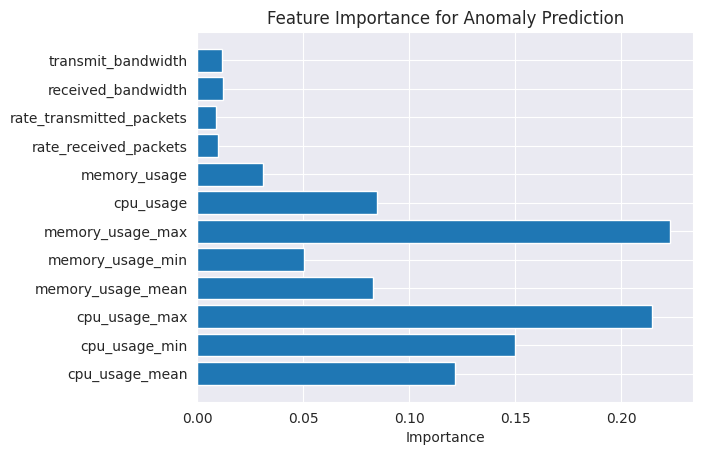

In [143]:
importances = clf.feature_importances_
plt.barh(features, importances)
plt.xlabel("Importance")
plt.title("Feature Importance for Anomaly Prediction")
plt.show()


In [111]:
topic_metrics

,topic,cpu_usage_mean,cpu_usage_min,cpu_usage_max,memory_usage_mean,memory_usage_min,memory_usage_max
0,-1,0.068664,0.000066,1.655518,2.279652e+09,3.966157e+07,5.415106e+09
1,0,0.031498,0.006888,0.049689,2.924002e+08,1.370726e+08,3.052012e+08
2,1,0.015841,0.002690,0.043873,2.325027e+08,2.250957e+08,2.410332e+08
3,2,0.015297,0.002164,0.046992,2.327945e+08,2.276844e+08,2.393907e+08
4,3,0.006880,0.001813,0.008114,1.384910e+08,1.042976e+08,1.405706e+08
...,...,...,...,...,...,...,...
963,962,0.075732,0.058888,0.087629,3.099372e+09,2.660483e+09,3.514335e+09
964,963,0.003443,0.003073,0.003651,1.409180e+08,1.366262e+08,1.434419e+08
965,964,0.003270,0.002913,0.003795,1.391170e+08,1.356923e+08,1.433682e+08
966,965,0.071879,0.063393,0.083992,3.086400e+09,2.438382e+09,3.514417e+09


In [87]:
topic_named = topic_metrics.merge(topic_info[['Topic', 'Representation']], 
                                  left_on='topic', right_on='Topic', how='left')
topic_named.sort_values('cpu_usage_mean', ascending=False)[['Representation', 'cpu_usage_mean']]

,Representation,cpu_usage_mean
895,[application httprestapplicationlibertyrestend...,2.278347
838,"[message error, srve0232e, br, error srve0232e...",2.168688
607,"[space, heap space, heap, java, java heap, jav...",2.137081
936,"[err, err err, error br, srve0232e, internal s...",2.136278
36,"[1012821, host, lookup, reattempt, contacted, ...",1.821809
...,...,...
518,"[received pod, pod received, synced, successfu...",0.001091
825,"[syncing status, skipping synchronisation, sta...",0.000686
282,"[device, serial, model, typepart, vendor, devd...",0.000131
616,"[device, typepart, model, vendor, serial, disc...",0.000129


In [30]:
topic_model.visualize_barchart(top_n_topics=10)
topic_model.visualize_topics()

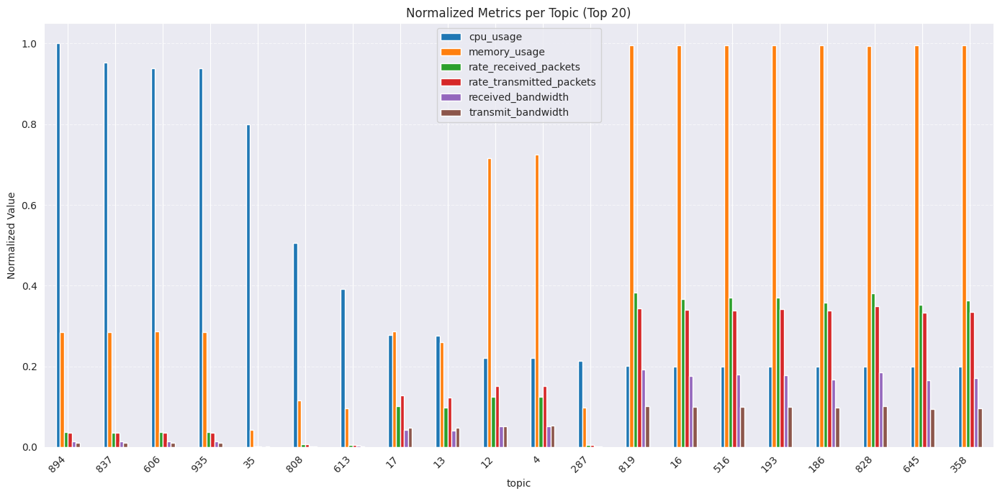

In [75]:
normalized_metrics = topic_metrics / topic_metrics.max()
top_norm = normalized_metrics.sort_values(by='cpu_usage', ascending=False).head(20)

ax = top_norm.plot(kind='bar', figsize=(14, 7))
plt.title("Normalized Metrics per Topic (Top 20)")
plt.ylabel("Normalized Value")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.grid(axis='y', linestyle='--', alpha=0.6)
plt.show()


In [83]:
top_norm_reset = top_norm.reset_index()

top_named = top_norm_reset.merge(
    topic_info[['Topic', 'Representation', 'Representative_Docs']],
    left_on='topic',
    right_on='Topic',
    how='left'
)

top_named.drop(columns='Topic', inplace=True)

top_named = top_named[['topic', 'Representation', 'Representative_Docs'] + [col for col in top_named.columns if col not in ['topic', 'Representation']]]

top_named.head(20)

,topic,Representation,Representative_Docs,cpu_usage,memory_usage,rate_received_packets,rate_transmitted_packets,received_bandwidth,transmit_bandwidth,Representative_Docs
0,894,[application httprestapplicationlibertyrestend...,[java heap space warning application httpresta...,1.000000,0.284630,0.036546,0.036317,0.014251,0.010469,[java heap space warning application httpresta...
1,837,"[message error, srve0232e, br, error srve0232e...",[error srve0232e internal server error <br> ex...,0.951869,0.284682,0.036383,0.036094,0.014046,0.010308,[error srve0232e internal server error <br> ex...
2,606,"[space, heap space, heap, java, java heap, jav...",[error srve0232e internal server error <br> ex...,0.937996,0.287572,0.036949,0.036341,0.014326,0.010438,[error srve0232e internal server error <br> ex...
3,935,"[err, err err, error br, srve0232e, internal s...",[error srve0232e internal server error <br> ex...,0.937644,0.284756,0.036655,0.035358,0.014236,0.010222,[error srve0232e internal server error <br> ex...
4,35,"[1012821, host, lookup, reattempt, contacted, ...",[agent contacted 19216857214 default gateway 1...,0.799619,0.043191,0.001040,0.000967,0.000118,0.001585,[agent contacted 19216857214 default gateway 1...
5,808,"[change info, info connectivity, connectivity ...",[info transport loopywriterrun returning conne...,0.504902,0.116337,0.006444,0.006324,0.002333,0.002492,[info transport loopywriterrun returning conne...
6,613,"[change info, info connectivity, connectivity ...",[info <> connectivity change <> info subchanne...,0.392584,0.095961,0.005704,0.005867,0.003952,0.002615,[info <> connectivity change <> info subchanne...
7,17,"[new connection, debugurllib3connectionpoolsta...",[debugurllib3connectionpoolstarting new connec...,0.278058,0.286011,0.102374,0.128994,0.042273,0.048683,[debugurllib3connectionpoolstarting new connec...
8,13,"[new connection, debugurllib3connectionpoolsta...",[<> <> http11 200 debugurllib3connectionpoolst...,0.276452,0.260021,0.098095,0.123657,0.040652,0.047650,[<> <> http11 200 debugurllib3connectionpoolst...
9,12,"[debugurllib3connectionpoolstarting, new conne...",[<> <> http11 200 <> debugurllib3connectionpoo...,0.220921,0.715514,0.123807,0.150719,0.051491,0.052519,[<> <> http11 200 <> debugurllib3connectionpoo...


In [60]:
top_norm

,cpu_usage,memory_usage,rate_received_packets,rate_transmitted_packets,received_bandwidth,transmit_bandwidth
topic,,,,,,
894,1.000000,0.284630,0.036546,0.036317,0.014251,0.010469
837,0.951869,0.284682,0.036383,0.036094,0.014046,0.010308
606,0.937996,0.287572,0.036949,0.036341,0.014326,0.010438
935,0.937644,0.284756,0.036655,0.035358,0.014236,0.010222
35,0.799619,0.043191,0.001040,0.000967,0.000118,0.001585
808,0.504902,0.116337,0.006444,0.006324,0.002333,0.002492
613,0.392584,0.095961,0.005704,0.005867,0.003952,0.002615
17,0.278058,0.286011,0.102374,0.128994,0.042273,0.048683
13,0.276452,0.260021,0.098095,0.123657,0.040652,0.047650


## Ruptures

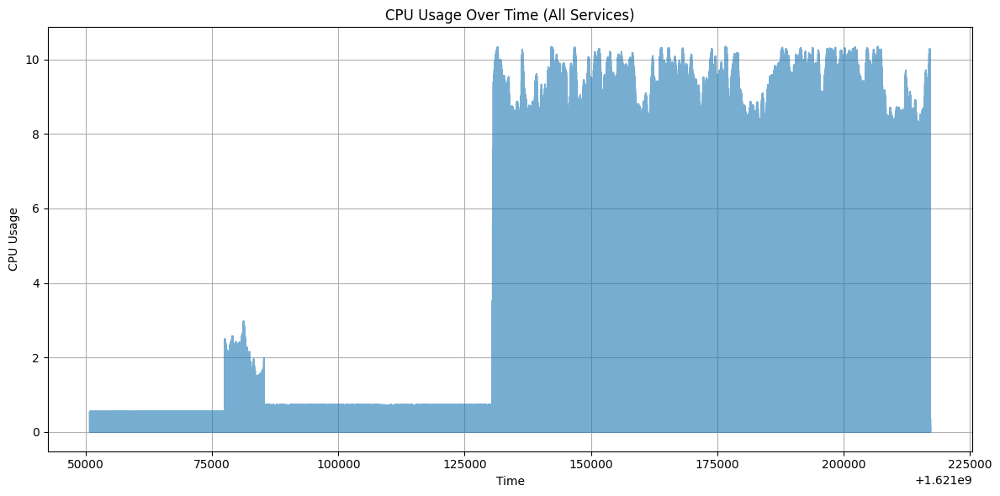

In [47]:
df_sorted = df_joined.sort_values(by='time')

plt.figure(figsize=(12, 6))
plt.plot(df_sorted['time'], df_sorted['cpu_usage'], alpha=0.6)
plt.xlabel('Time')
plt.ylabel('CPU Usage')
plt.title('CPU Usage Over Time (All Services)')
plt.grid(True)
plt.tight_layout()
plt.show()

In [51]:
from multiprocessing import Process

def detect_change_points():
    import ruptures as rpt
    df_sorted = df_joined.sort_values(by="time")
    y = df_sorted['cpu_usage'].values.reshape(-1, 1)
    model = rpt.Pelt(model="l2").fit(y)
    cp = model.predict(pen=20)
    print("Change points:", cp)

if __name__ == "__main__":
    p = Process(target=detect_change_points)
    p.start()
    p.join()  

Process Process-4:
Traceback (most recent call last):
  File "/usr/lib/python3.10/multiprocessing/process.py", line 314, in _bootstrap
    self.run()
  File "/usr/lib/python3.10/multiprocessing/process.py", line 108, in run
    self._target(*self._args, **self._kwargs)


KeyboardInterrupt: 

  File "/tmp/ipykernel_27587/3374303098.py", line 8, in detect_change_points
    cp = model.predict(pen=20)
  File "/home/alona/alona/McS/Applied_Data_Science/Thesis/Code/pythonProject/.venv/lib/python3.10/site-packages/ruptures/detection/pelt.py", line 130, in predict
    partition = self._seg(pen)
  File "/home/alona/alona/McS/Applied_Data_Science/Thesis/Code/pythonProject/.venv/lib/python3.10/site-packages/ruptures/detection/pelt.py", line 71, in _seg
    tmp_partition.update({(t, bkp): self.cost.error(t, bkp) + pen})


In [ ]:
segment_labels = np.zeros(len(y_cpu), dtype=int)
start = 0
for i, end in enumerate(cp):
    segment_labels[start:end] = i
    start = end

# Add segment info to your DataFrame
df_joined['regime'] = segment_labels

In [ ]:
merged_df = X_df_sparse.merge(df_joined, on=['service', 'time'], how='inner')
merged_df

In [ ]:
from sklearn.preprocessing import StandardScaler

models = {}
scores = []

for regime_id in merged_df['regime'].unique():
    df_regime = merged_df[merged_df['regime'] == regime_id]
    
    X_regime = df_regime.drop(columns=['service', 'time', 'cpu_usage', 'memory_usage', 'service_type', 'rate_received_packets',
                            'rate_transmitted_packets', 'received_bandwidth', 'transmit_bandwidth', 'latency'])
    scaler = StandardScaler(with_mean=False)
    X_scaled = scaler.fit_transform(X_regime)
    
    y_regime = np.log1p(df_regime['cpu_usage'])
    
    if len(X_regime) < 50:
        continue  # Skip tiny segments
    
    X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_regime, test_size=0.2, random_state=42)
    
    model = RandomForestRegressor(n_estimators=100, random_state=42, n_jobs=-1)
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    r2 = r2_score(y_test, y_pred)
    print(f"Regime {regime_id} R²: {r2:.3f}")
    
    models[regime_id] = model
    scores.append(r2)


In [84]:
feat_importance = pd.Series(model.feature_importances_, index=X.columns).sort_values(ascending=True)

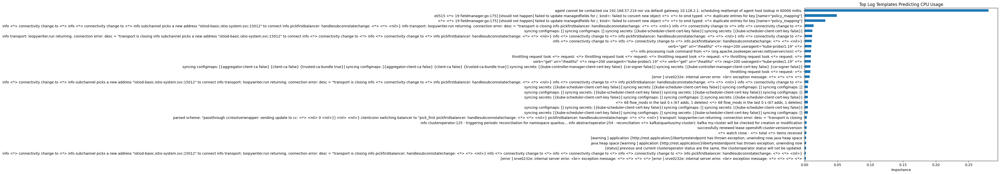

In [86]:
top_n = 30
top_feat_importance = feat_importance.sort_values(ascending=False).head(top_n)

plt.figure(figsize=(10, 8))
top_feat_importance.sort_values().plot(kind='barh')  # ascending for horizontal bar chart
plt.title("Top Log Templates Predicting CPU Usage")
plt.xlabel("Importance")
#plt.tight_layout()
plt.show()

In [88]:
top_logs = top_feat_importance.sort_values(ascending=False).head(5)
print(top_logs)

agent cannot be contacted via 192.168.57.214 nor via default gateway 10.128.2.1. scheduling reattempt of agent host lookup in 60000 millis.                                                                                                                                                                                                                                                                                                                         0.280182
e0515 <*> 19 fieldmanager.go:175] [should not happen] failed to update managedfields for /, kind=: failed to convert new object <*> <*> to smd typed: <*> duplicate entries for key [name="policy_mapping"]                                                                                                                                                                                                                                                         0.049001
<*> <*> 19 fieldmanager.go:175] [should not happen] failed to update managedfi

In [89]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y_memory, test_size=0.2, random_state=42
)

In [90]:
model.fit(X_train, y_train)

RandomForestRegressor(n_jobs=-1, random_state=42)

In [91]:
y_pred = model.predict(X_test)

# Evaluate
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
r2  = r2_score(y_test, y_pred)
print(f"MAE: {mae:.3f}")
print(f"MSE: {mse:.3f}")
print(f"R² score: {r2:.3f}")

MAE: 537078068.464
MSE: 1564512231591835392.000
R² score: 0.303


In [92]:
feat_importance = pd.Series(model.feature_importances_, index=X.columns).sort_values(ascending=True)

/tmp/ipykernel_57739/774615748.py:8: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


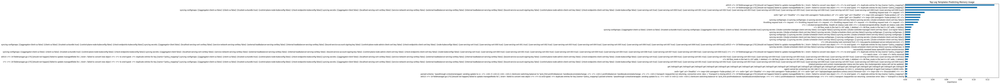

In [93]:
top_n = 30
top_feat_importance = feat_importance.sort_values(ascending=False).head(top_n)

plt.figure(figsize=(10, 8))
top_feat_importance.sort_values().plot(kind='barh')  # ascending for horizontal bar chart
plt.title("Top Log Templates Predicting Memory Usage")
plt.xlabel("Importance")
plt.tight_layout()
plt.show()

In [96]:
top_words = top_feat_importance.index.tolist()
top_words[:5]

['e0515 <*> 19 fieldmanager.go:175] [should not happen] failed to update managedfields for /, kind=: failed to convert new object <*> <*> to smd typed: <*> duplicate entries for key [name="policy_mapping"]',
 '<*> <*> 19 fieldmanager.go:175] [should not happen] failed to update managedfields for /, kind=: failed to convert new object <*> <*> to smd typed: <*> duplicate entries for key [name="policy_mapping"]',
 'syncing configmaps: [{aggregator-client-ca false} {client-ca false} {trusted-ca-bundle true} {control-plane-node-kubeconfig false} {check-endpoints-kubeconfig false}] syncing secrets: [{aggregator-client false} {localhost-serving-cert-certkey false} {service-network-serving-certkey false} {external-loadbalancer-serving-certkey false} {internal-loadbalancer-serving-certkey false} {bound-service-account-signing-key false} {control-plane-node-admin-client-cert-key false} {check-endpoints-client-cert-key false} {node-kubeconfigs false} {user-serving-cert true} {user-serving-cert-00

In [97]:
for word in top_words[:5]:
    print(f"\n=== Logs containing: '{word}' ===")
    matches = logs[logs['LogTemplate'].str.contains(rf'\b{word}\b', regex=True)]
    print(matches['LogTemplate'].value_counts().head(5))  # show most common ones


=== Logs containing: 'e0515 <*> 19 fieldmanager.go:175] [should not happen] failed to update managedfields for /, kind=: failed to convert new object <*> <*> to smd typed: <*> duplicate entries for key [name="policy_mapping"]' ===
Series([], Name: count, dtype: int64)

=== Logs containing: '<*> <*> 19 fieldmanager.go:175] [should not happen] failed to update managedfields for /, kind=: failed to convert new object <*> <*> to smd typed: <*> duplicate entries for key [name="policy_mapping"]' ===
Series([], Name: count, dtype: int64)

=== Logs containing: 'syncing configmaps: [{aggregator-client-ca false} {client-ca false} {trusted-ca-bundle true} {control-plane-node-kubeconfig false} {check-endpoints-kubeconfig false}] syncing secrets: [{aggregator-client false} {localhost-serving-cert-certkey false} {service-network-serving-certkey false} {external-loadbalancer-serving-certkey false} {internal-loadbalancer-serving-certkey false} {bound-service-account-signing-key false} {control-plane-

error: bad character range r-c at position 33

## DEBUG:urllib3.connectionpool:http://reviews:9080 "GET /reviews/0 HTTP/1.1" <*> <*>  contributes the most to high memory usage

# Count Encoding Instead of TF-IDF (bag-of-words encoding):

In [58]:
from sklearn.feature_extraction.text import CountVectorizer

vectorizer = CountVectorizer(analyzer='word', token_pattern=r'.+') #matches entire log

X_count = vectorizer.fit_transform(log_docs['LogTemplate'])

In [59]:
X_count.shape

(2178585, 538607)

In [60]:
X_df = pd.DataFrame.sparse.from_spmatrix(
    X_count,
    columns=vectorizer.get_feature_names_out()
)

In [61]:
X_df['service'] = log_docs['service'].values
X_df['time'] = log_docs['time'].values
X_df

"deleting object" <*> <*> kind="pod" propagationpolicy=background "deleting object" <*> <*> kind="pod" propagationpolicy=background "deleting object" <*> <*> kind="pod" propagationpolicy=background "deleting object" <*> <*> kind="pod" propagationpolicy=background "event occurred" <*> kind="cronjob" apiversion="batch/v1beta1" type="normal" <*> <*> job <*> "event occurred" <*> kind="cronjob" apiversion="batch/v1beta1" type="normal" <*> <*> job <*> "processing object" <*> <*> kind="pod "processing object" <*> <*> kind="pod "deleting object" <*> <*> kind="pod" propagationpolicy=background "deleting object" <*> <*> kind="pod" propagationpolicy=background  \
0                                                        0                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                   
1                                                        0                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                   
2                                                        0                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                   
3                                                        0                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                   
4                                                        0                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                         

In [62]:
merged_df_bow = X_df.merge(df_joined, on=['service', 'time'], how='inner')
merged_df_bow

KeyboardInterrupt: 

In [52]:
y_cpu = merged_df_bow['cpu_usage']
y_memory = merged_df_bow['memory_usage']

X = merged_df_bow.drop(columns=['service', 'time', 'cpu_usage', 'memory_usage', 'service_type', 'rate_received_packets', 'rate_transmitted_packets', 'received_bandwidth', 'transmit_bandwidth', 'latency'])

In [53]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
    X, y_cpu, test_size=0.2, random_state=42
)

In [54]:
model.fit(X_train, y_train)

RandomForestRegressor(n_jobs=-1, random_state=42)

In [55]:
y_pred = model.predict(X_test)

# Evaluate
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
r2  = r2_score(y_test, y_pred)
print(f"MAE: {mae:.3f}")
print(f"MSE: {mse:.3f}")
print(f"R² score: {r2:.3f}")

MAE: 0.027
MSE: 0.050
R² score: 0.413


In [56]:
feat_importance = pd.Series(model.feature_importances_, index=X.columns).sort_values(ascending=True)

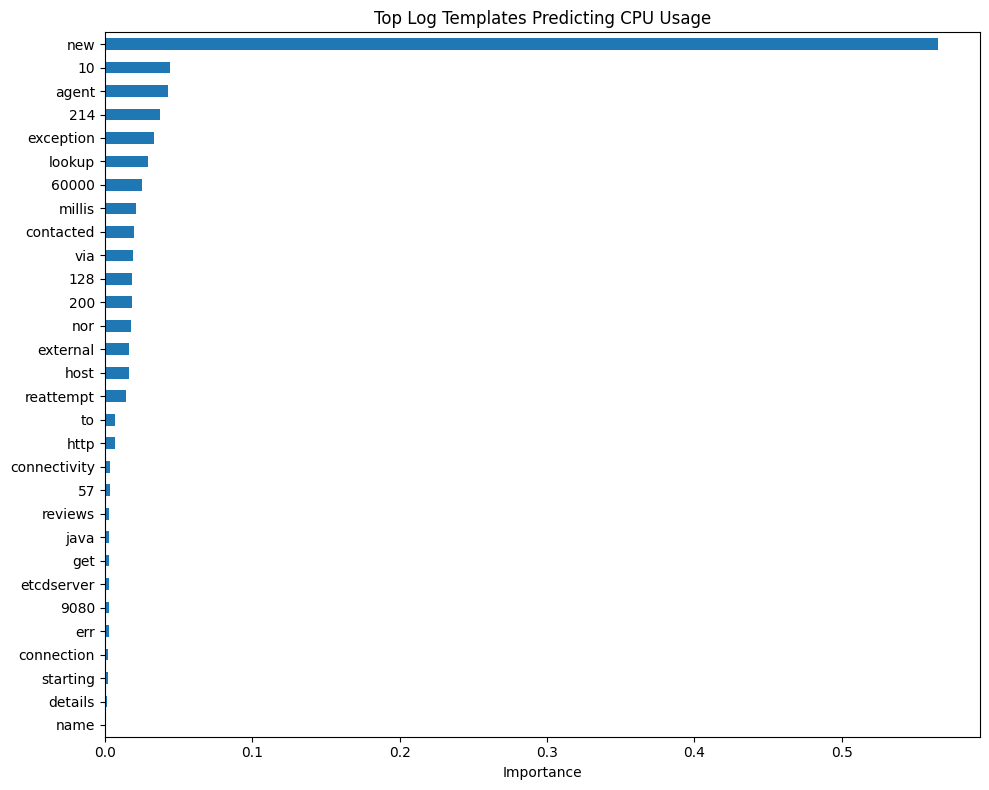

In [57]:
top_n = 30
top_feat_importance = feat_importance.sort_values(ascending=False).head(top_n)

plt.figure(figsize=(10, 8))
top_feat_importance.sort_values().plot(kind='barh')  # ascending for horizontal bar chart
plt.title("Top Log Templates Predicting CPU Usage")
plt.xlabel("Importance")
plt.tight_layout()
plt.show()

## log counts

In [11]:
# Aggregate log counts per service, time, and template
log_counts = logs.groupby(['service', 'time', 'LogTemplate']).size().reset_index(name='count')
log_counts

,service,time,LogTemplate,count
0,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621050870,INFO AbstractOperator:254 - Reconciliation <*>...,1
1,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621050870,INFO ClusterOperator:125 - Triggering periodic...,1
2,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621050874,INFO AbstractOperator:493 - Reconciliation <*>...,1
3,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621050990,INFO AbstractOperator:254 - Reconciliation <*>...,1
4,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621050990,INFO ClusterOperator:125 - Triggering periodic...,1
...,...,...,...,...
4427018,web-7565876947-rr4gm,1621215518,info <*> Connectivity change to <*>,4
4427019,web-7565876947-rr4gm,1621215518,"info Subchannel picks a new address ""istiod-ba...",1
4427020,web-7565876947-rr4gm,1621215518,info pickfirstBalancer: HandleSubConnStateChan...,2
4427021,web-7565876947-rr4gm,1621215518,info transport: loopyWriter.run returning. con...,1


In [12]:
log_counts['service_type'] = log_counts['service'].str.split('-').str[0]
log_counts

,service,time,LogTemplate,count,service_type
0,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621050870,INFO AbstractOperator:254 - Reconciliation <*>...,1,amq
1,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621050870,INFO ClusterOperator:125 - Triggering periodic...,1,amq
2,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621050874,INFO AbstractOperator:493 - Reconciliation <*>...,1,amq
3,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621050990,INFO AbstractOperator:254 - Reconciliation <*>...,1,amq
4,amq-streams-cluster-operator-v1.7.1-6d6cd6474-...,1621050990,INFO ClusterOperator:125 - Triggering periodic...,1,amq
...,...,...,...,...,...
4427018,web-7565876947-rr4gm,1621215518,info <*> Connectivity change to <*>,4,web
4427019,web-7565876947-rr4gm,1621215518,"info Subchannel picks a new address ""istiod-ba...",1,web
4427020,web-7565876947-rr4gm,1621215518,info pickfirstBalancer: HandleSubConnStateChan...,2,web
4427021,web-7565876947-rr4gm,1621215518,info transport: loopyWriter.run returning. con...,1,web


In [ ]:
# Pivot to wide format: one column per LogTemplate
log_features = log_counts.pivot_table(index=['service','time'], 
                                      columns='LogTemplate', values='count', fill_value=0)
log_features

In [ ]:
logs_df = pd.read_parquet(base_model / "logs.parquet")
df_joined = pd.read_parquet(base_model / "df_joined.parquet")

data = df_joined.merge(log_features, on=['service','time'], how='left')